<a href="https://colab.research.google.com/github/PavanPratapagiri/topic_modeling/blob/main/algorithms/BERT/bert.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# @title
import pandas as pd
from bertopic import BERTopic
from transformers import BertTokenizer


In [ ]:
from wordcloud import WordCloud

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

In [ ]:
import numpy as np

In [ ]:
!pip install nltk
import nltk

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
!pip install bertopic

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.5/158.5 kB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 13.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.7/85.7 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.5/171.5 kB 14.0 MB/s eta 0:00:00
  Using cached Cython-0.29.37-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.manylinux_2_24_x86_64.whl (1.9 MB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 6.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (73

In [ ]:
data = pd.read_csv("/content/nytimes_news_articles.csv")

In [ ]:
data['content'].values[0]

'WASHINGTON — Stellar pitching kept the Mets afloat in the first half of last season despite their offensive woes. But they cannot produce an encore of their pennant-winning season if their lineup keeps floundering while their pitching is nicked, bruised and stretched thin.\n “We were going to ride our pitching,” Manager Terry Collins said before Wednesday’s game. “But we’re not riding it right now. We’ve got as many problems with our pitching as we do anything.”\n Wednesday’s 4-2 loss to the Washington Nationals was cruel for the already-limping Mets. Pitching in Steven Matz’s place, the spot starter Logan Verrett allowed two runs over five innings. But even that was too large a deficit for the Mets’ lineup to overcome against Max Scherzer, the Nationals’ starter.\n “We’re not even giving ourselves chances,” Collins said, adding later, “We just can’t give our pitchers any room to work.”\n The Mets did not score until the ninth inning, when a last-gasp two-run homer by James Loney off 

In [ ]:
data['content'] = data['content'].astype(str)

In [ ]:
data

,date,news_category,headline,content,url,clean_content
0,2016-06-30,sports-baseball,Washington Nationals Max Scherzer Baffles Mets...,WASHINGTON — Stellar pitching kept the Mets af...,http://www.nytimes.com/2016/06/30/sports/baseb...,washington — stellar pitching kept mets afloat...
1,2016-06-30,nyregion,Mayor De Blasios Counsel To Leave Next Month T...,Mayor Bill de Blasio’s counsel and chief legal...,http://www.nytimes.com/2016/06/30/nyregion/may...,mayor bill de blasio’s counsel chief legal adv...
2,2016-06-30,nyregion,Three Men Charged In Killing Of Cuomo Administ...,In the early morning hours of Labor Day last y...,http://www.nytimes.com/2016/06/30/nyregion/thr...,"early morning hours labor day last year, group..."
3,2016-06-30,nyregion,Tekserve Precursor To The Apple Store To Close...,It was the Apple Store in New York City before...,http://www.nytimes.com/2016/06/30/nyregion/tek...,apple store new york city thing apple store. i...
4,2016-06-30,sports-olympics,Once At Michael Phelpss Feet And Still Chasing...,OMAHA — The United States Olympic swimming tri...,http://www.nytimes.com/2016/06/30/sports/olymp...,omaha — united states olympic swimming trials ...
...,...,...,...,...,...,...
8882,2016-04-18,nyregion,Man Killed In Police Shooting In Queens Author...,New York City officers shot and killed a 32-ye...,http://www.nytimes.com/2016/04/18/nyregion/man...,new york city officers shot killed 32-year-old...
8883,2016-04-18,us-politics,Battle For Senate,There is a second critical contest in America’...,http://www.nytimes.com/2016/04/18/us/politics/...,second critical contest america’s 2016 electio...
8884,2016-04-18,nyregion,He Said His Car Had Been Stolen The Police Say...,"On April 1, police officers from the 108th Pre...",http://www.nytimes.com/2016/04/18/nyregion/he-...,"april 1, police officers 108th precinct called..."
8885,2016-04-18,world-asia,Farmers In Arid India Share Camps With Their C...,"KHILAD, India — The cattle camp, on a dusty ba...",http://www.nytimes.com/2016/04/18/world/asia/f...,"khilad, india — cattle camp, dusty back road l..."


In [ ]:
# Drop rows with missing values in the 'content' column
data = data.dropna(subset=['content'])

In [ ]:
# Preprocess text data
# Convert text to lowercase, remove punctuation, and remove stopwords

data['clean_content'] = data['content'].str.lower()
data['clean_content'] = data['clean_content'].str.replace('[^\w\s]', '')
data['clean_content'] = data['clean_content'].apply(lambda x: ' '.join([word for word in x.split() if word not in nltk.corpus.stopwords.words('english')]))

In [ ]:
# Tokenize articles using BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [ ]:
# Define the maximum length for truncation
max_length = 512  # Set your desired maximum length here

# Tokenize and truncate articles
tokenized_articles_list = []
for index, row in data.iterrows():
    tokenized_article = tokenizer(row['content'], truncation=True, max_length=max_length, return_tensors='pt')
    tokenized_articles_list.append(tokenized_article.input_ids.tolist())

In [ ]:
# Remove None values from tokenized_articles
tokenized_articles = [tokenized_article for tokenized_article in tokenized_articles if tokenized_article is not None]

In [ ]:
tokenized_articles = [str(token) for token in tokenized_articles_list]

In [ ]:
len(tokenized_articles_list)

8887

In [ ]:
# Initialize and fit BERTopic model
model = BERTopic(language="english")
topics, _ = model.fit_transform(tokenized_articles)

In [ ]:
# Assign topics to the DataFrame
data['topic_label'] = topics

In [ ]:
# View the topics
print(data[['url', 'news_category','topic_label']])

                                                    url    news_category  \
0     http://www.nytimes.com/2016/06/30/sports/baseb...  sports-baseball   
1     http://www.nytimes.com/2016/06/30/nyregion/may...         nyregion   
2     http://www.nytimes.com/2016/06/30/nyregion/thr...         nyregion   
3     http://www.nytimes.com/2016/06/30/nyregion/tek...         nyregion   
4     http://www.nytimes.com/2016/06/30/sports/olymp...  sports-olympics   
...                                                 ...              ...   
8882  http://www.nytimes.com/2016/04/18/nyregion/man...         nyregion   
8883  http://www.nytimes.com/2016/04/18/us/politics/...      us-politics   
8884  http://www.nytimes.com/2016/04/18/nyregion/he-...         nyregion   
8885  http://www.nytimes.com/2016/04/18/world/asia/f...       world-asia   
8886  http://www.nytimes.com/2016/04/18/movies/jj-ab...           movies   

      topic_label  
0              -1  
1              22  
2              -1  
3      

In [ ]:
# Get the top n news categories
top_categories = data['news_category'].value_counts().head(10)
print(top_categories)

news_category
nyregion             663
us-politics          608
us                   589
business-dealbook    382
world-europe         358
world-asia           356
business             332
fashion-weddings     329
sports-baseball      281
fashion              257
Name: count, dtype: int64


In [ ]:
top_topics = model.get_topic_freq().head(10)
print(top_topics)

    Topic  Count
0      -1   5919
15      0    202
21      1    145
57      2    122
10      3     96
16      4     84
20      5     74
30      6     74
25      7     73
19      8     68


In [ ]:
# Visualize the topics using the topic_labels_ attribute
model.visualize_topics(topics=model.topic_labels_)

Topic Label: -1


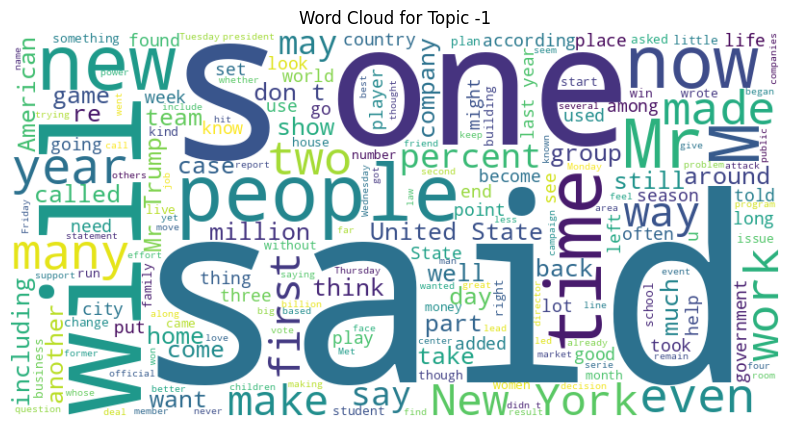

Topic Label: 22


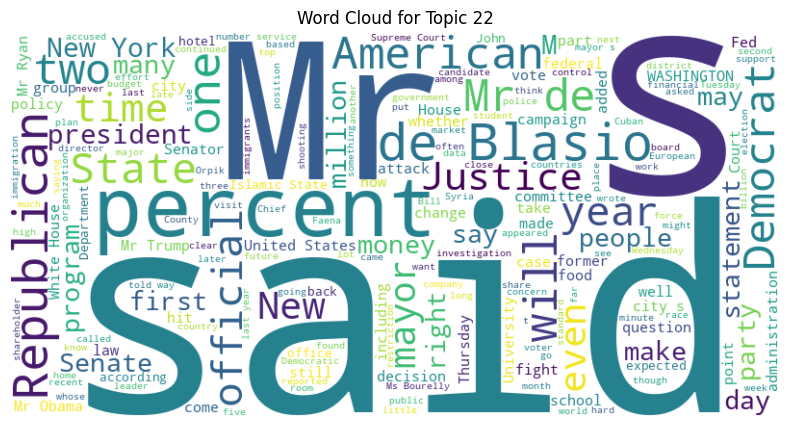

Topic Label: 20


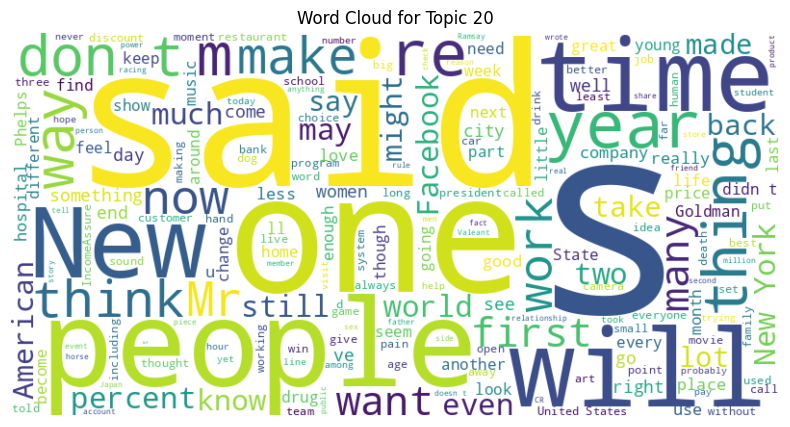

Topic Label: 11


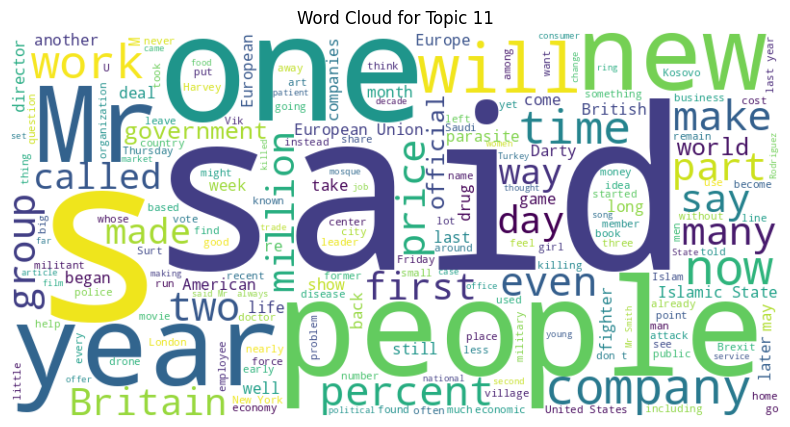

Topic Label: 74


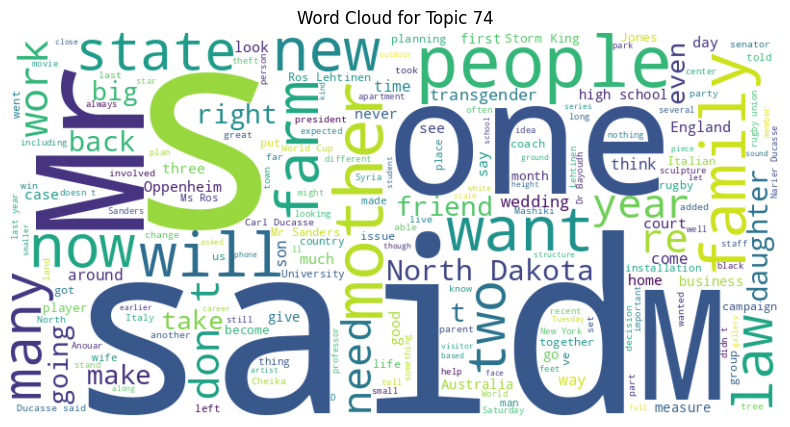

Topic Label: 30


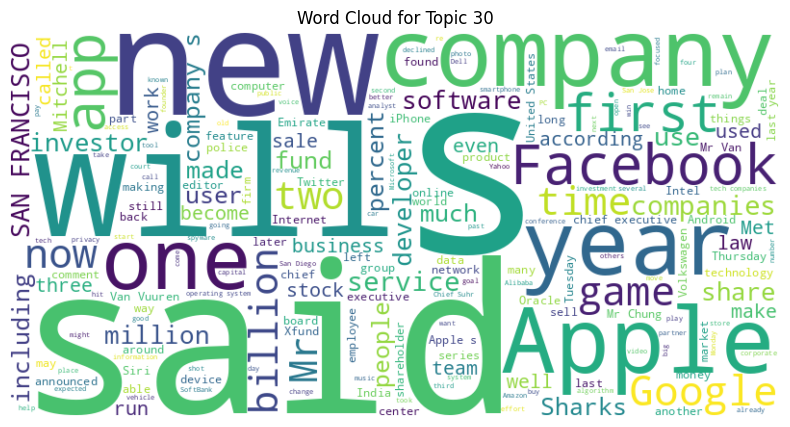

Topic Label: 14


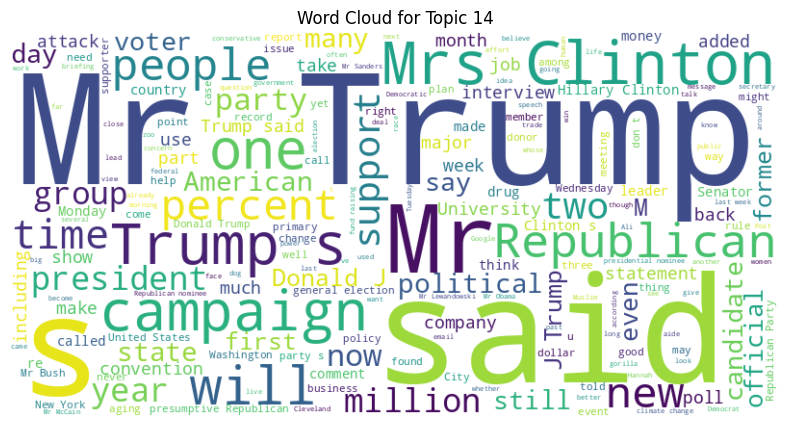

Topic Label: 42


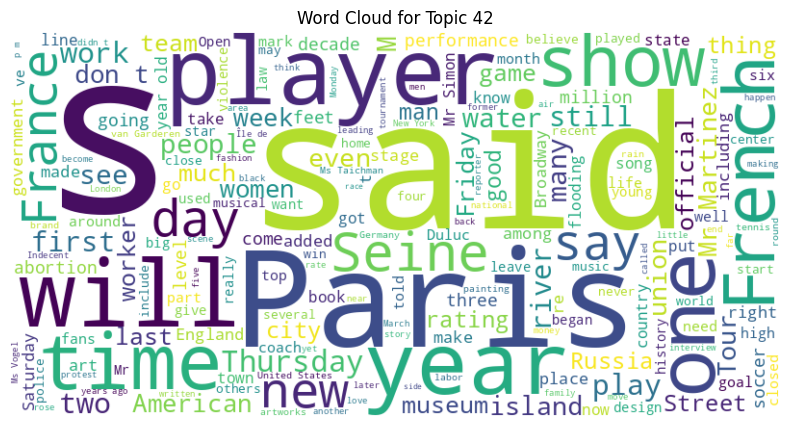

Topic Label: 9


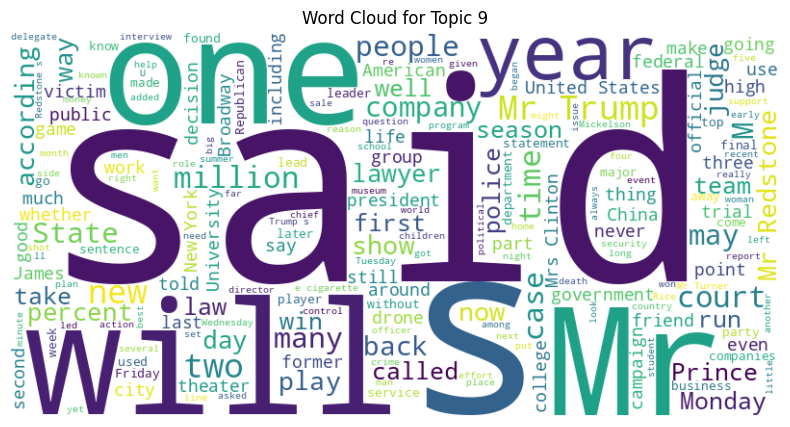

Topic Label: 13


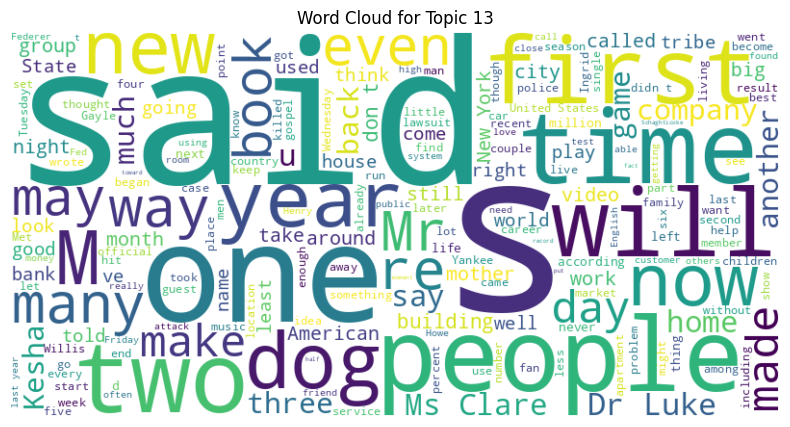

Topic Label: 3


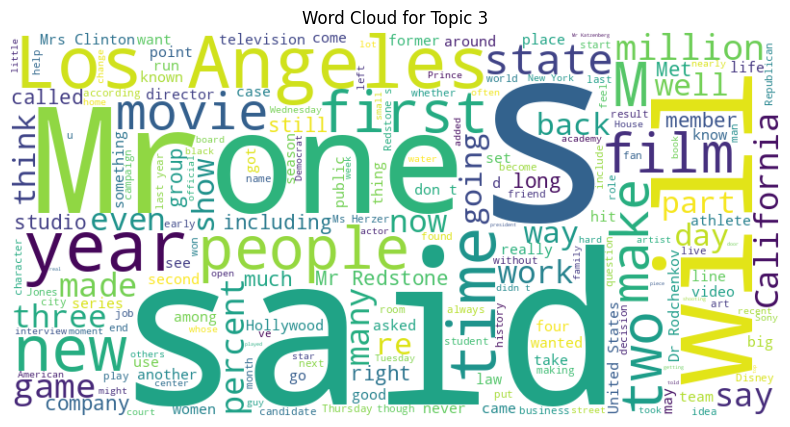

Topic Label: 33


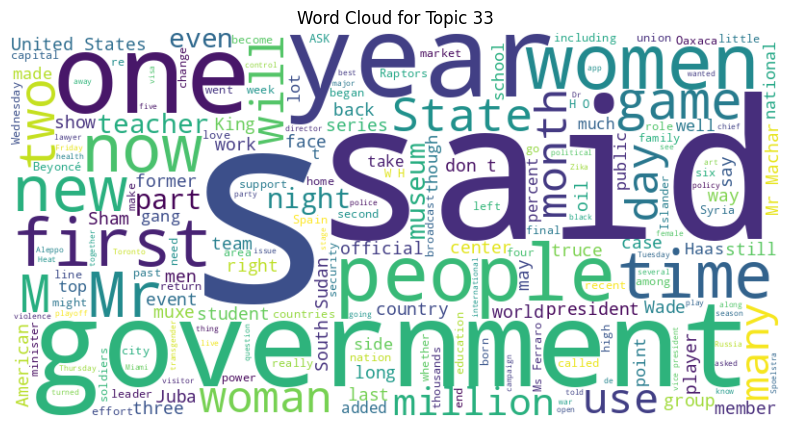

Topic Label: 84


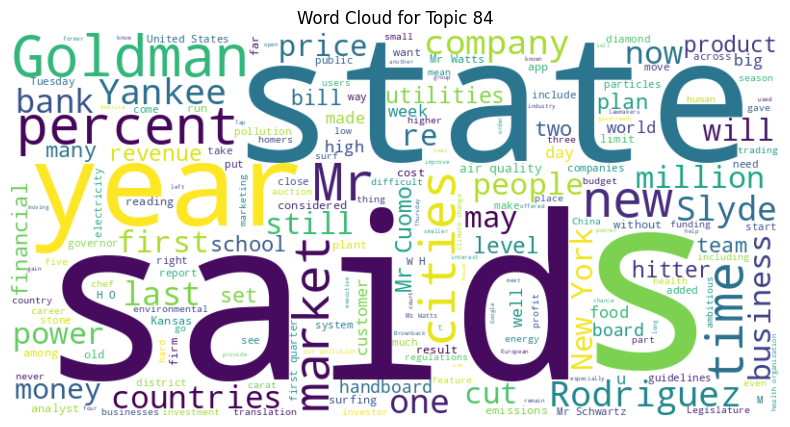

Topic Label: 45


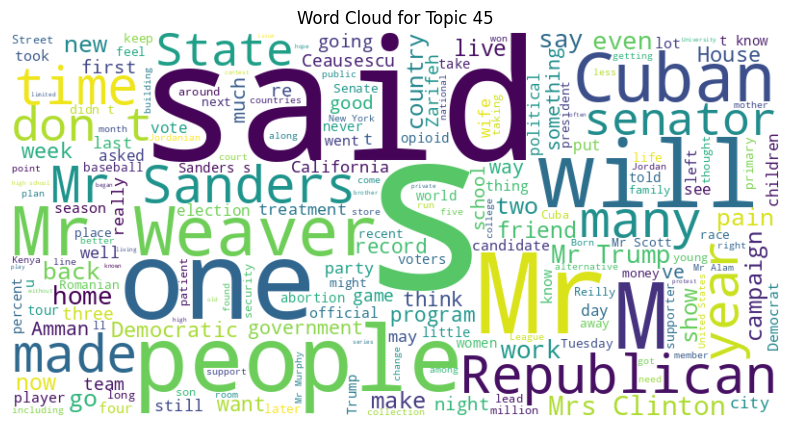

Topic Label: 25


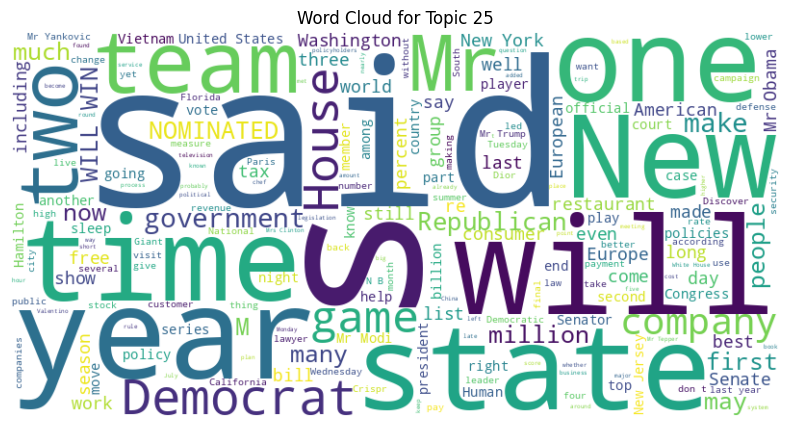

Topic Label: 0


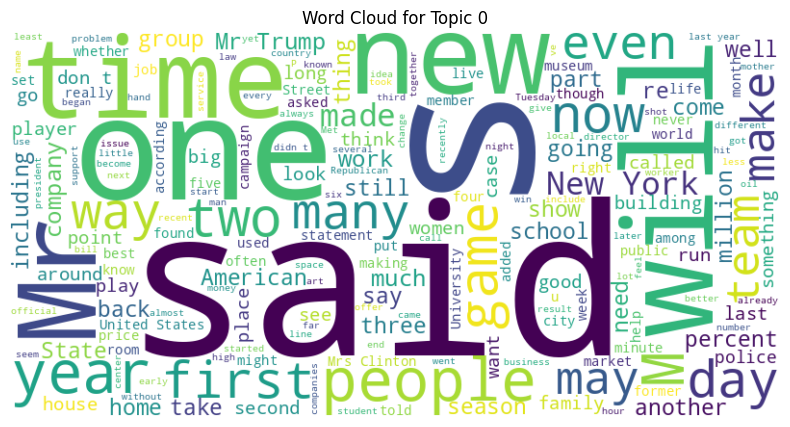

Topic Label: 4


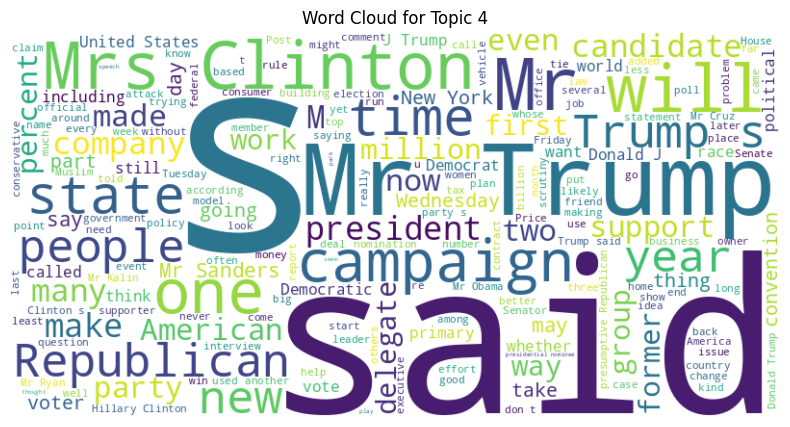

Topic Label: 48


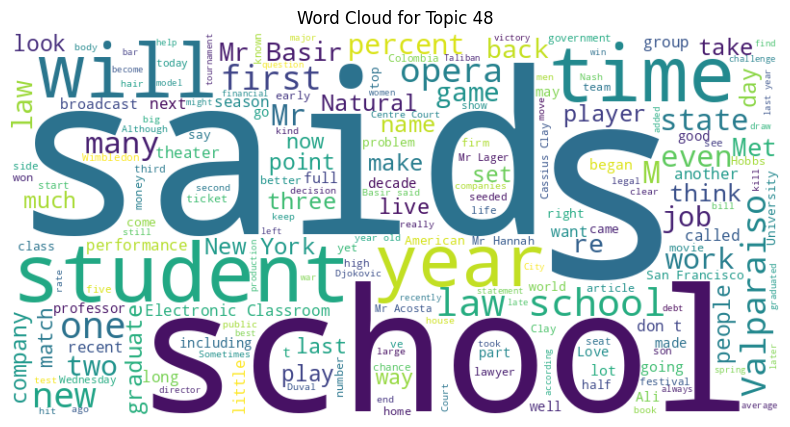

Topic Label: 40


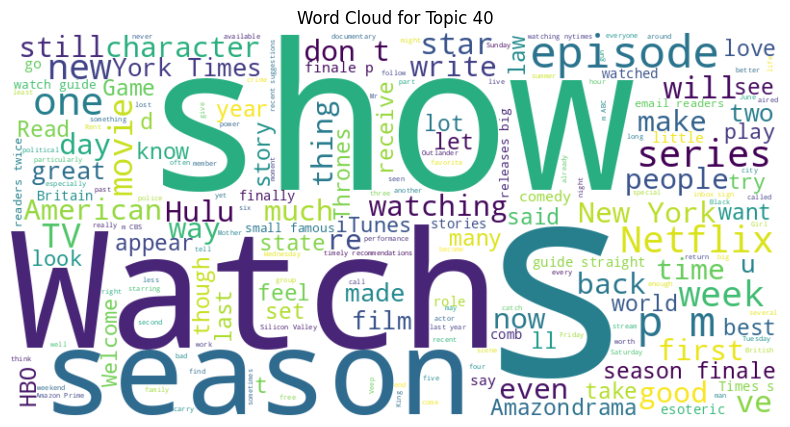

Topic Label: 8


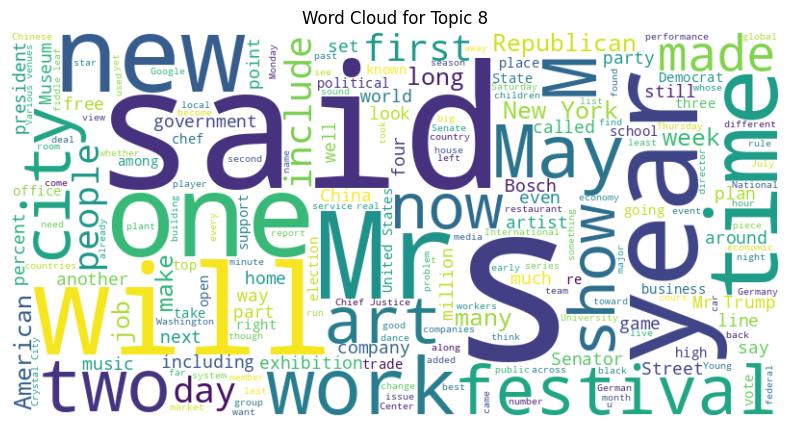

Topic Label: 5


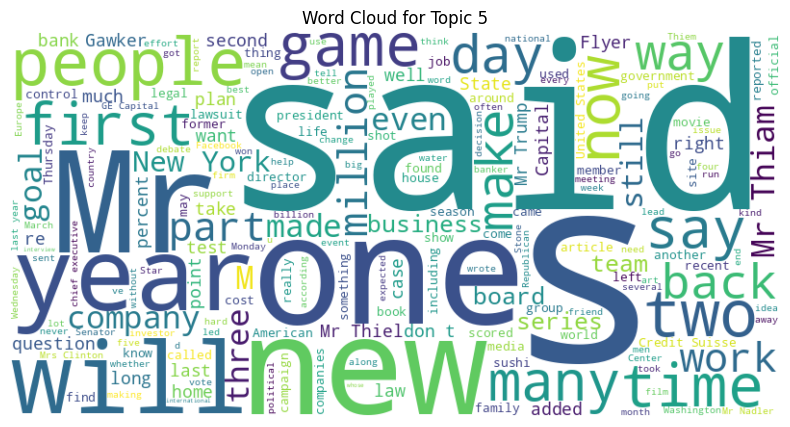

Topic Label: 1


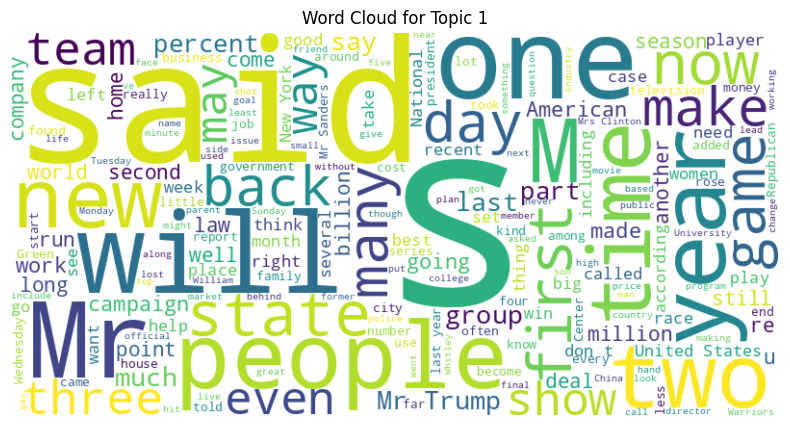

Topic Label: 21


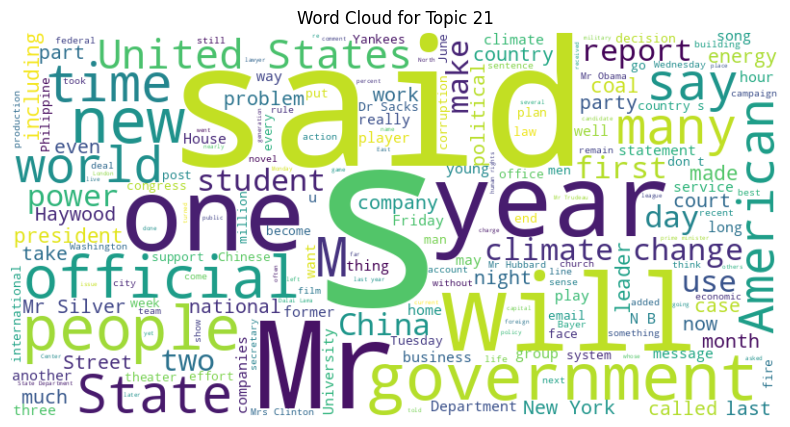

Topic Label: 34


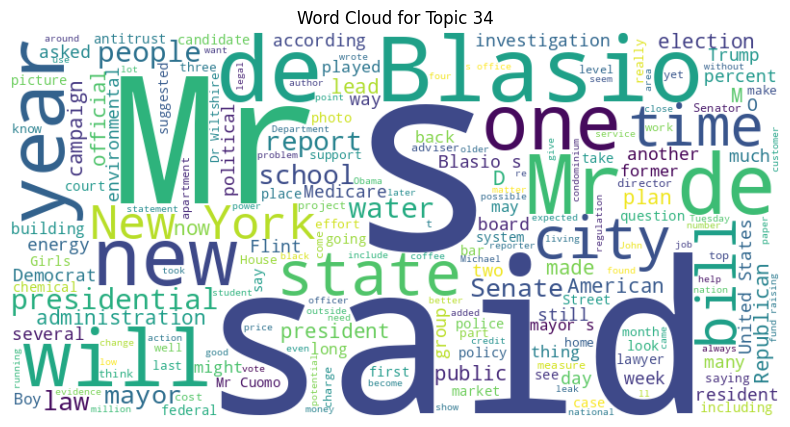

Topic Label: 27


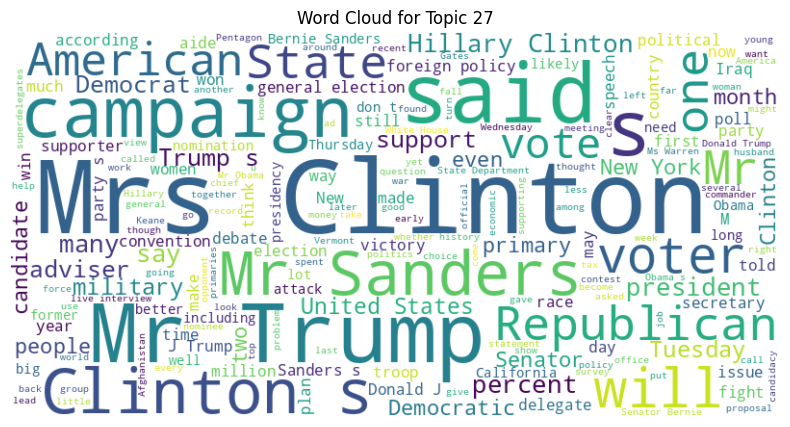

Topic Label: 7


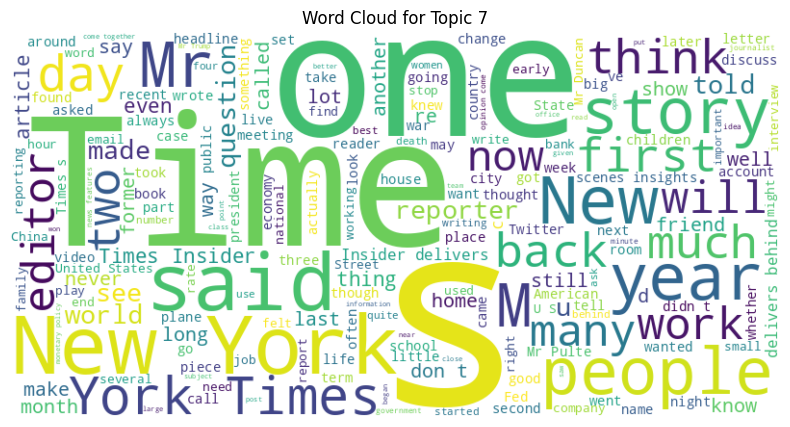

Topic Label: 10


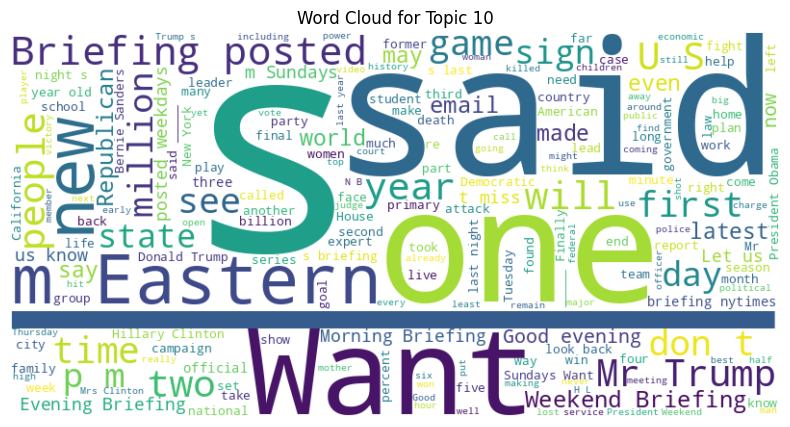

Topic Label: 88


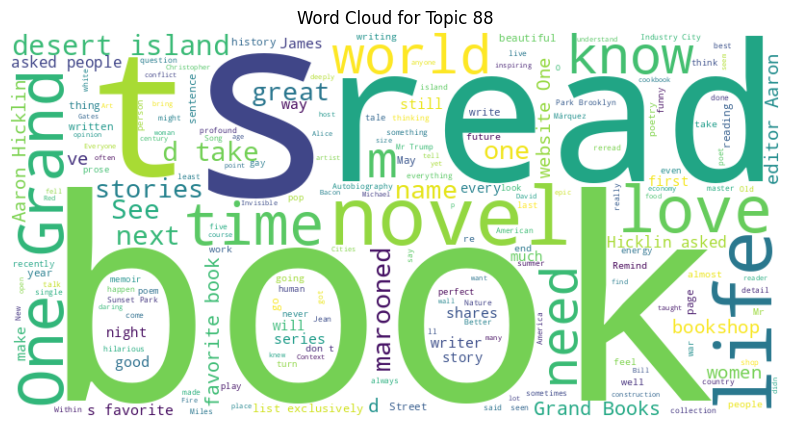

Topic Label: 44


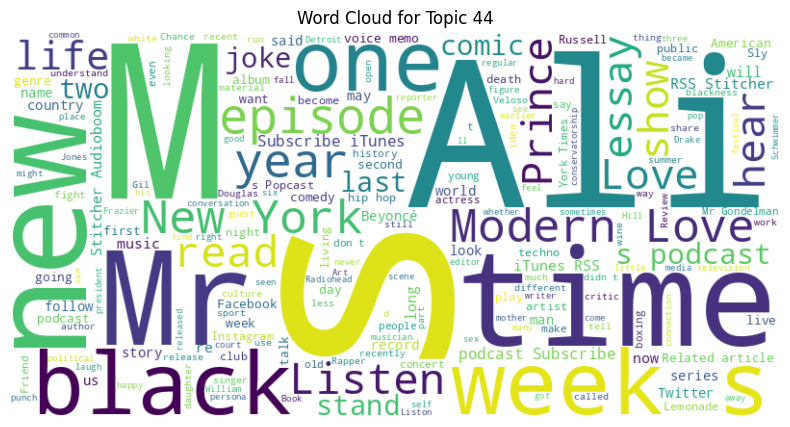

Topic Label: 90


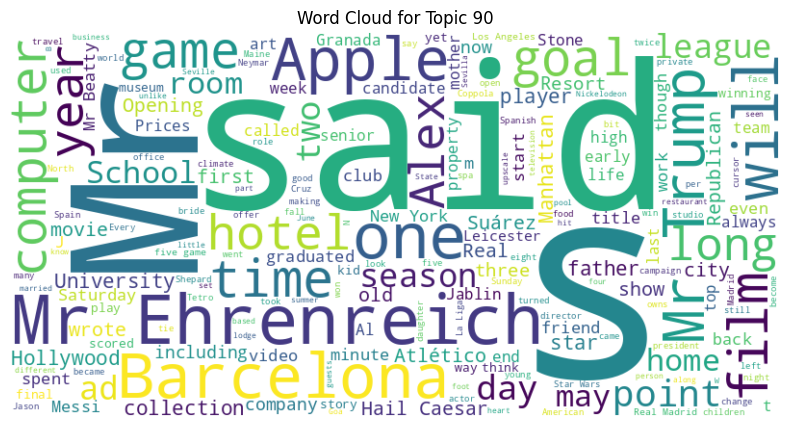

Topic Label: 6


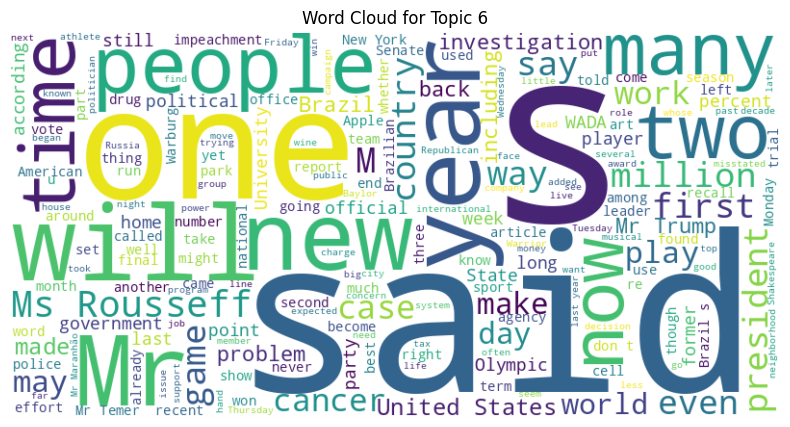

Topic Label: 24


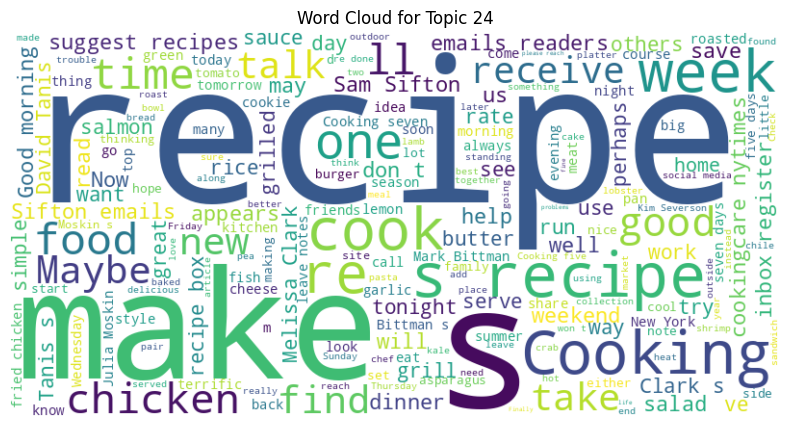

Topic Label: 67


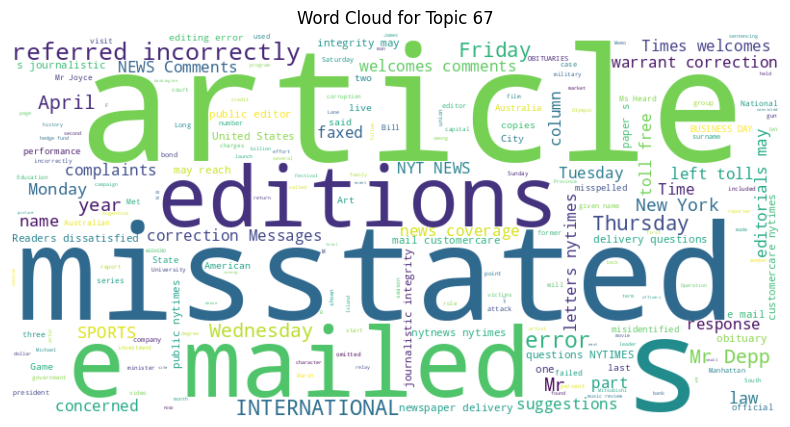

Topic Label: 66


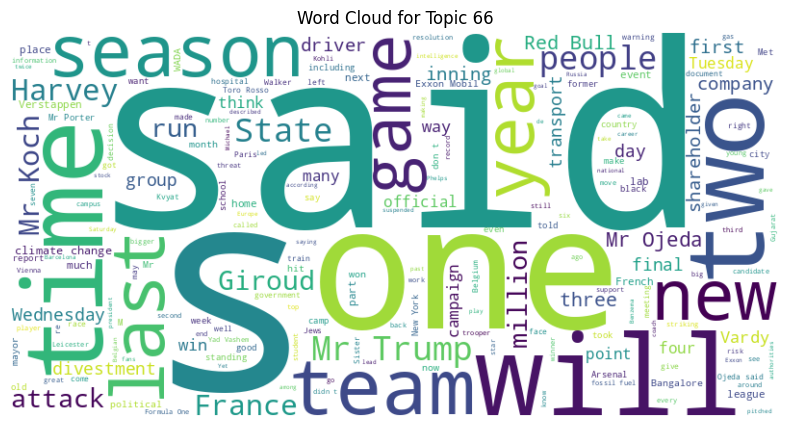

Topic Label: 70


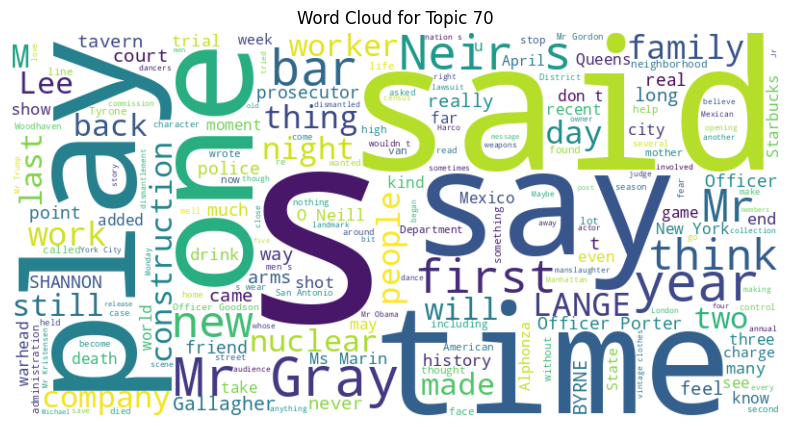

Topic Label: 23


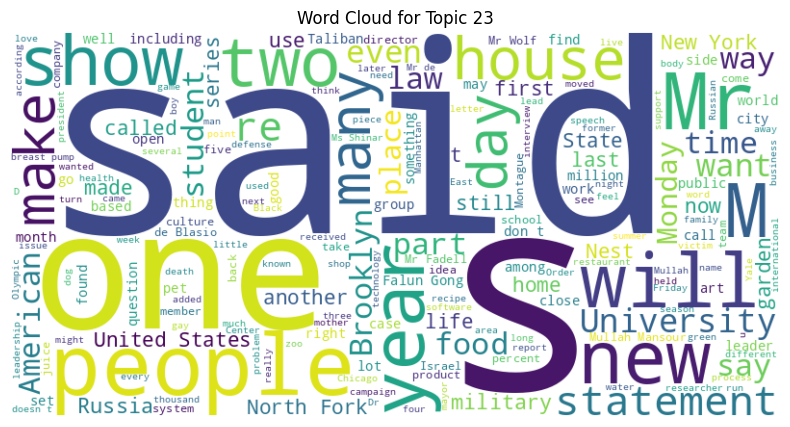

Topic Label: 47


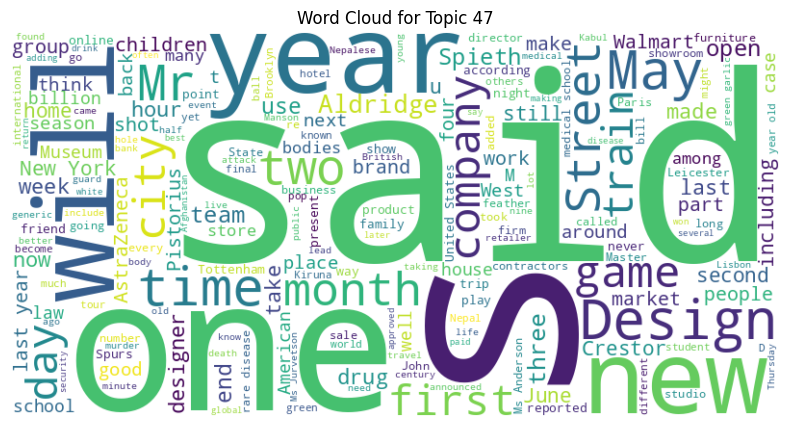

Topic Label: 17


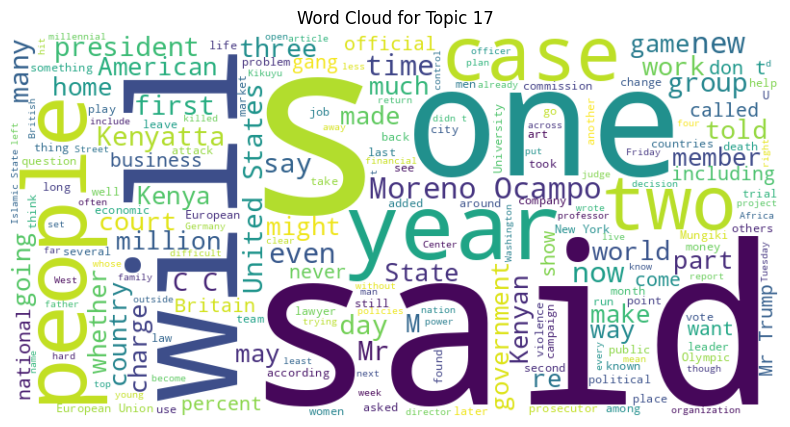

Topic Label: 16


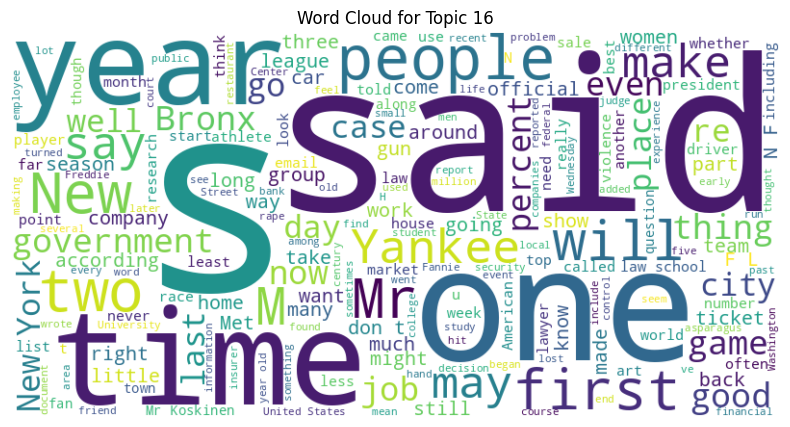

Topic Label: 12


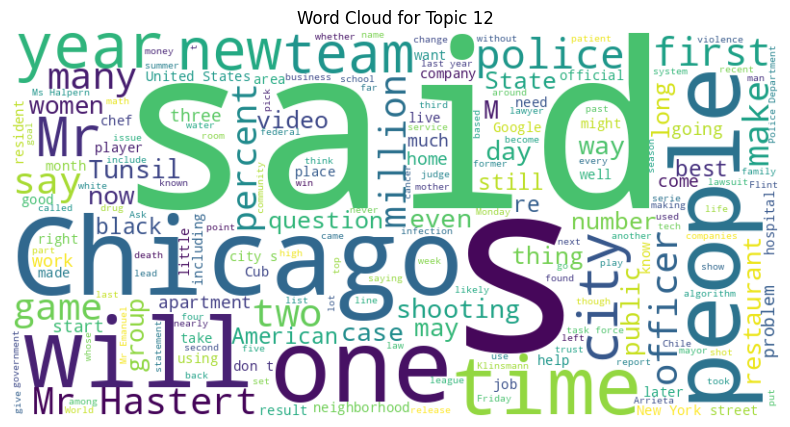

Topic Label: 62


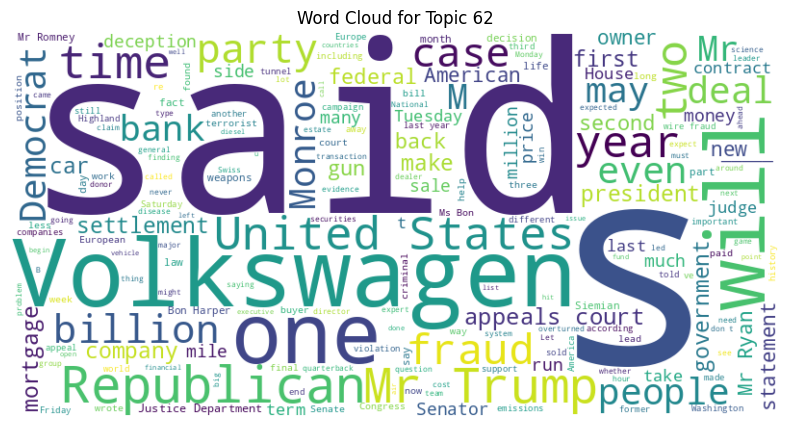

Topic Label: 39


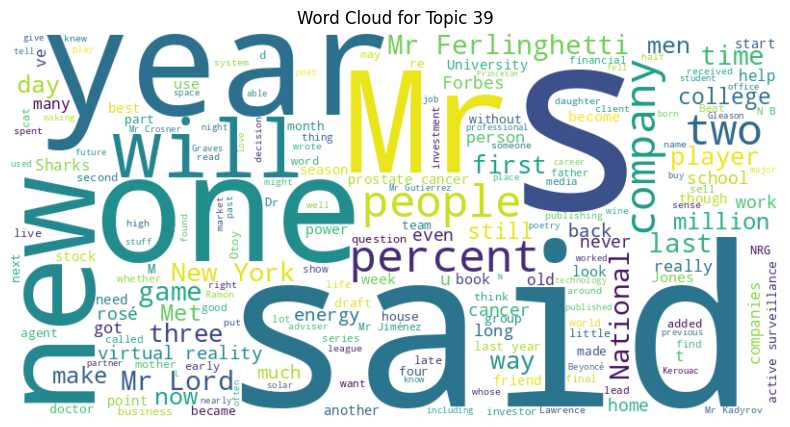

Topic Label: 41


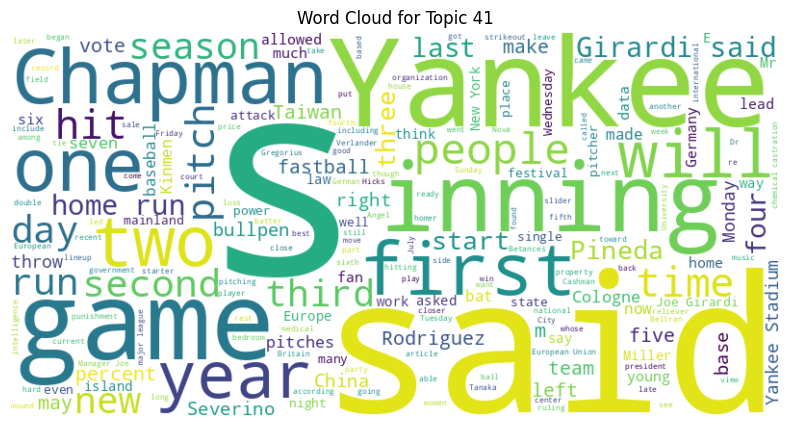

Topic Label: 26


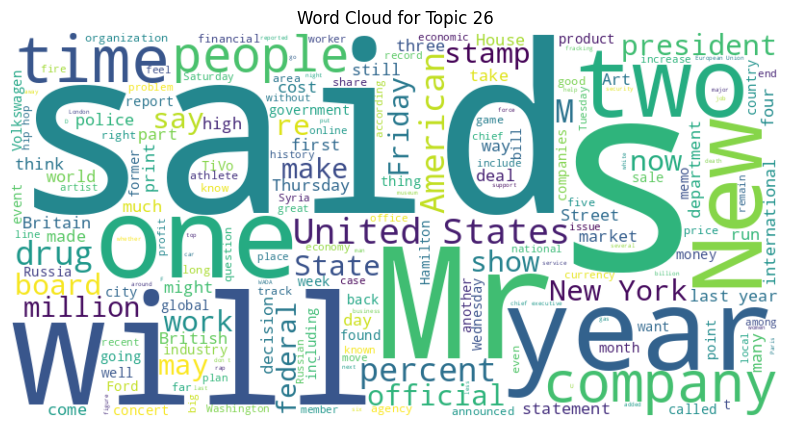

Topic Label: 91


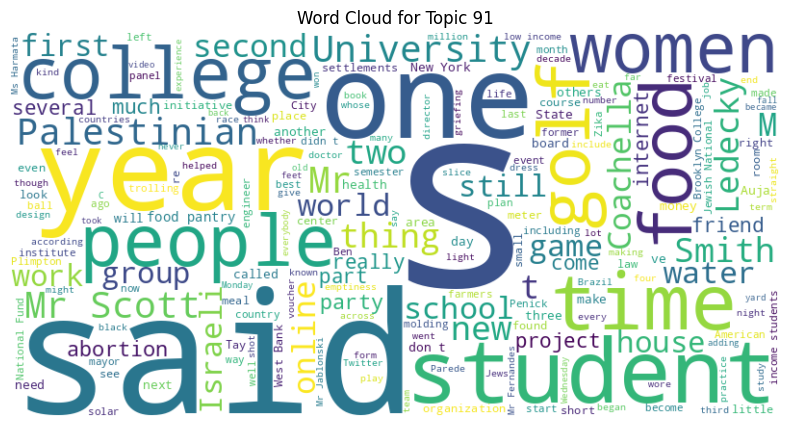

Topic Label: 59


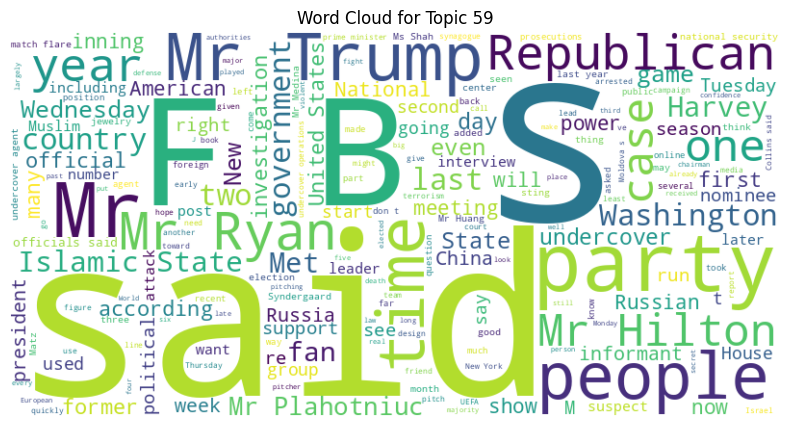

Topic Label: 58


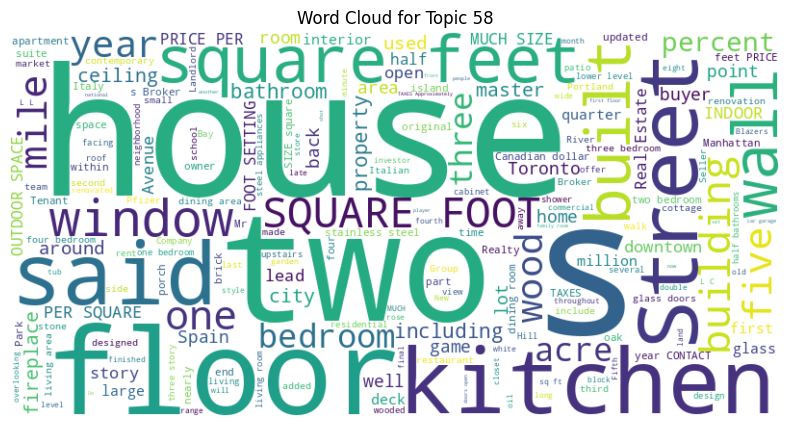

Topic Label: 19


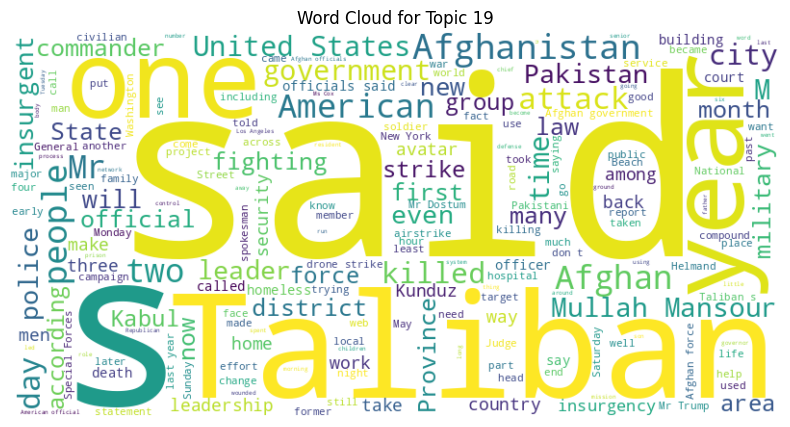

Topic Label: 57


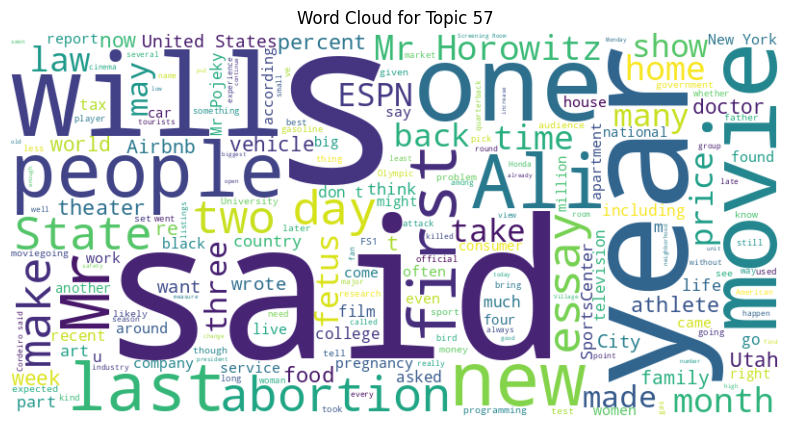

Topic Label: 50


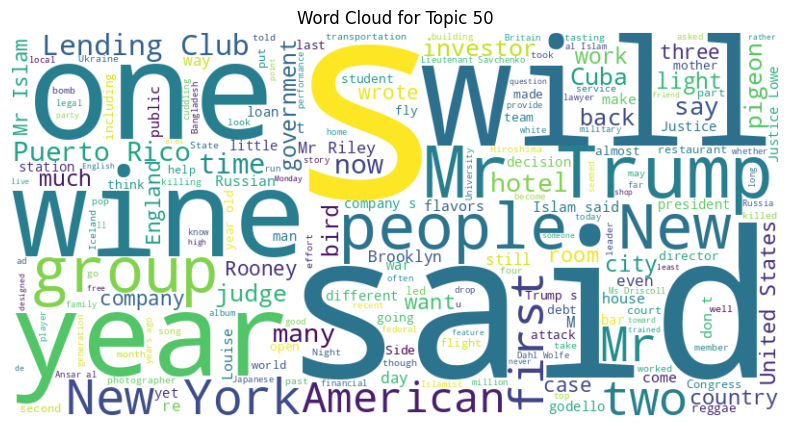

Topic Label: 55


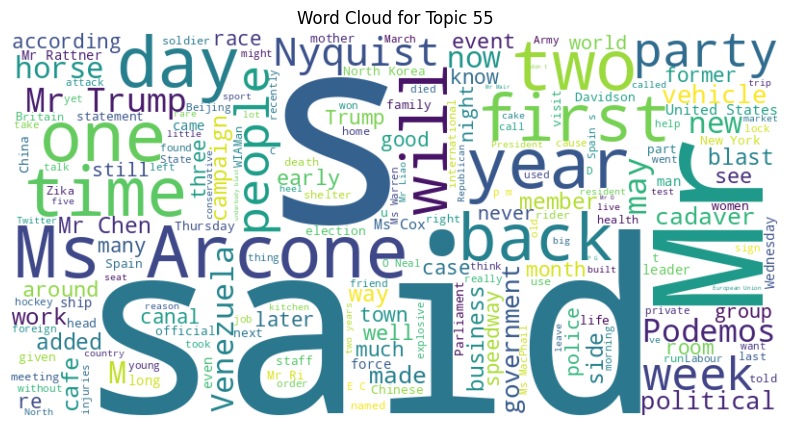

Topic Label: 32


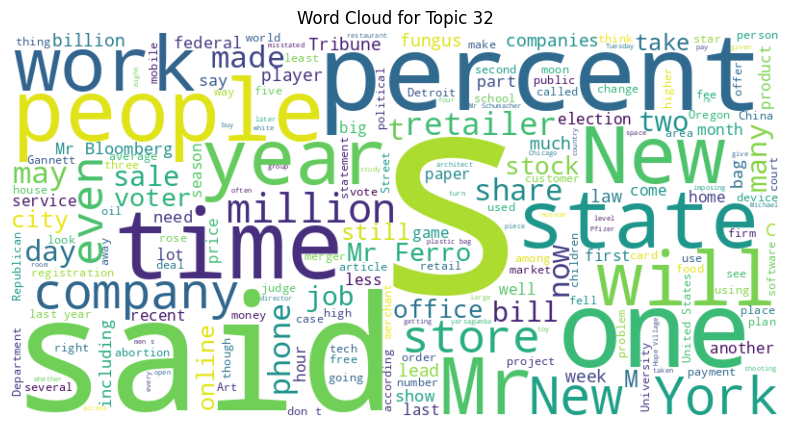

Topic Label: 31


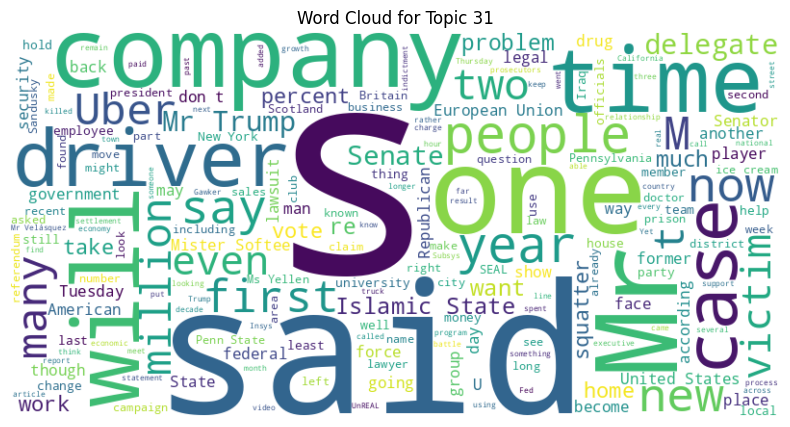

Topic Label: 18


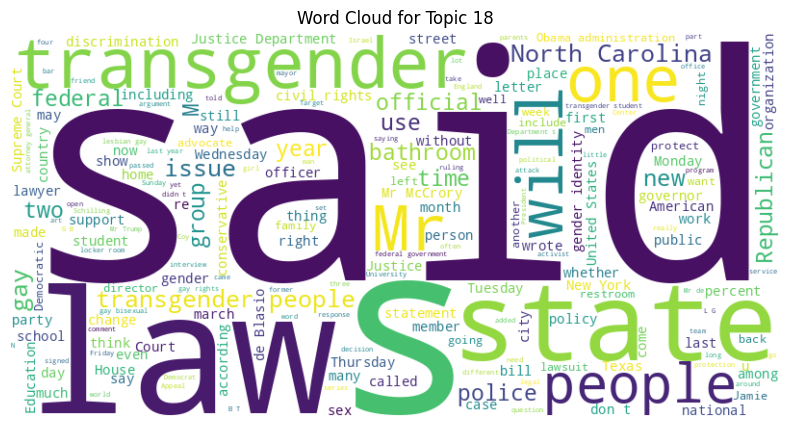

Topic Label: 36


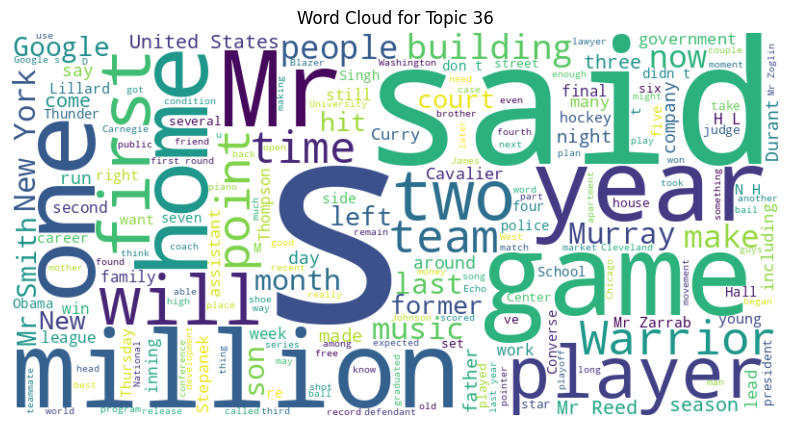

Topic Label: 35


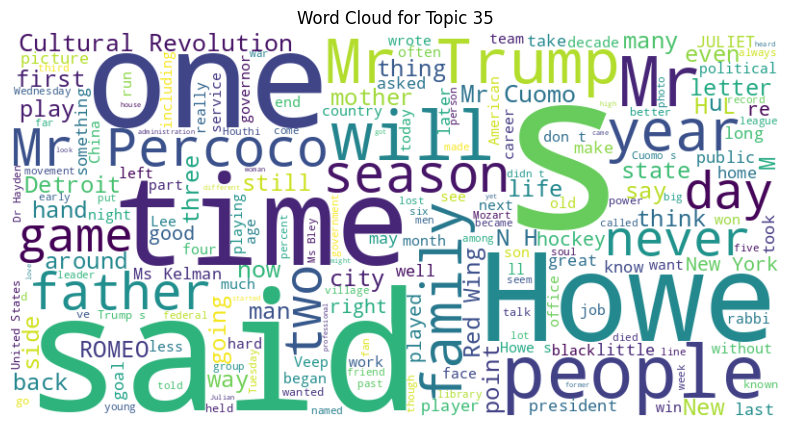

Topic Label: 15


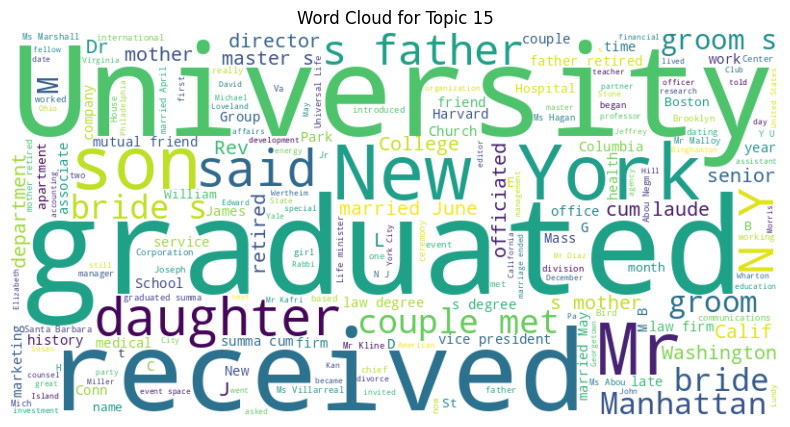

Topic Label: 2


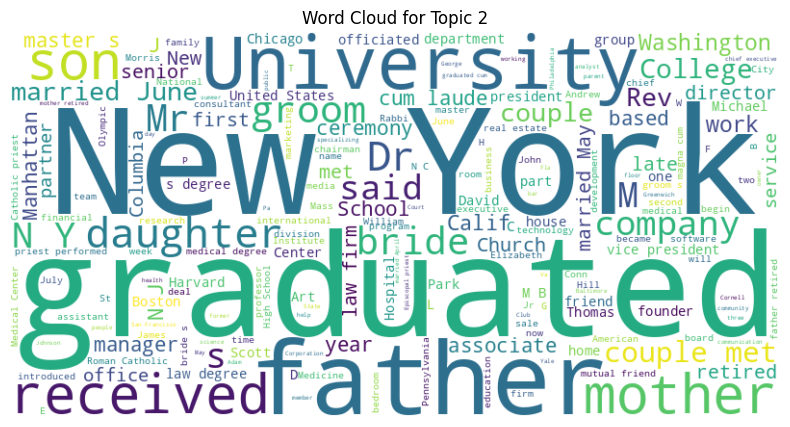

Topic Label: 65


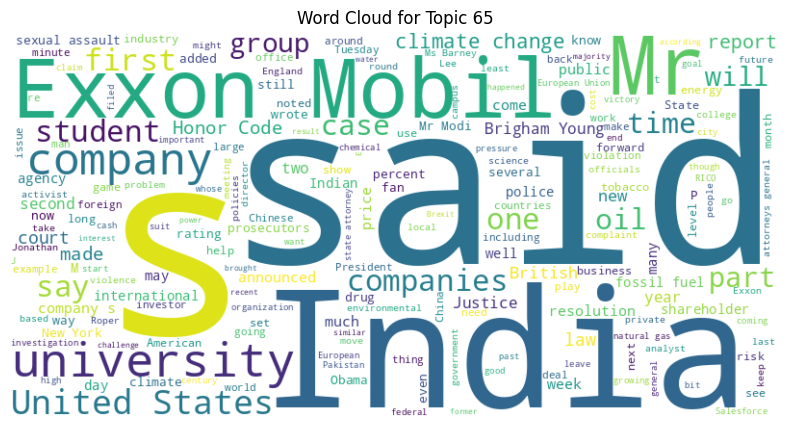

Topic Label: 80


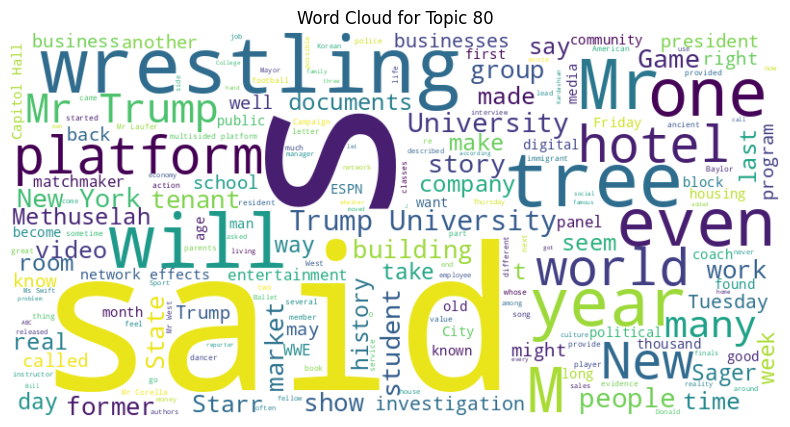

Topic Label: 64


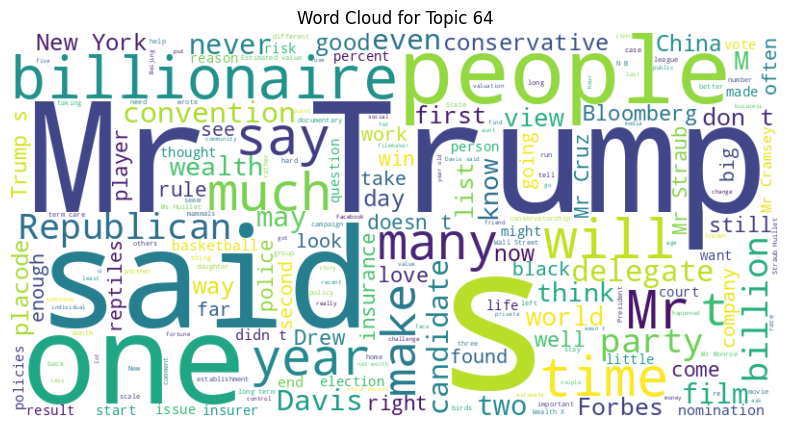

Topic Label: 77


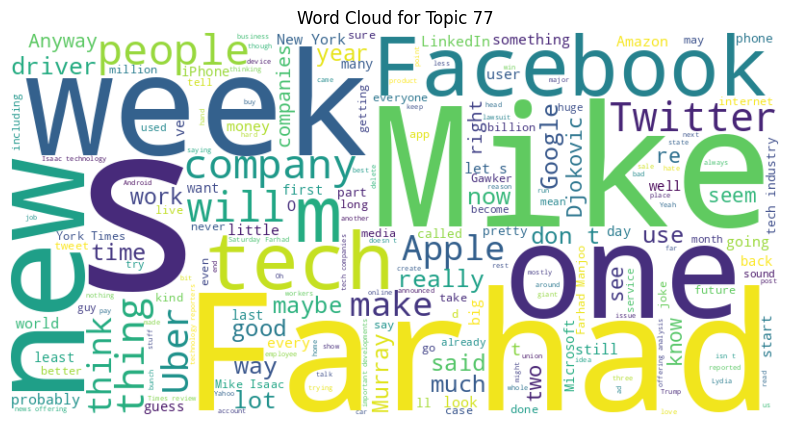

Topic Label: 43


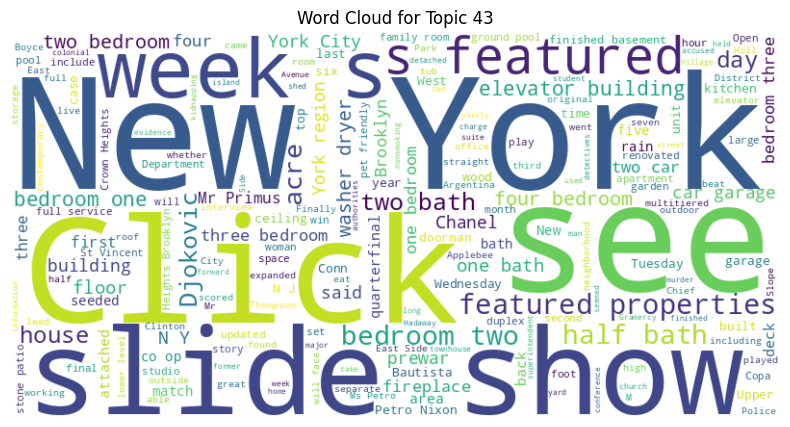

Topic Label: 46


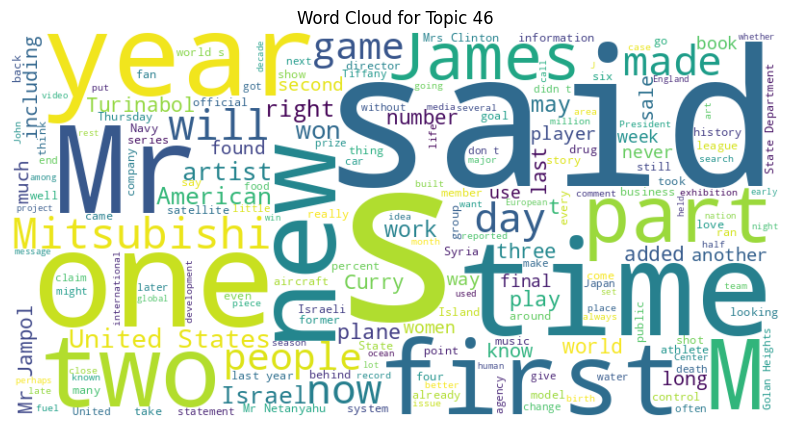

Topic Label: 71


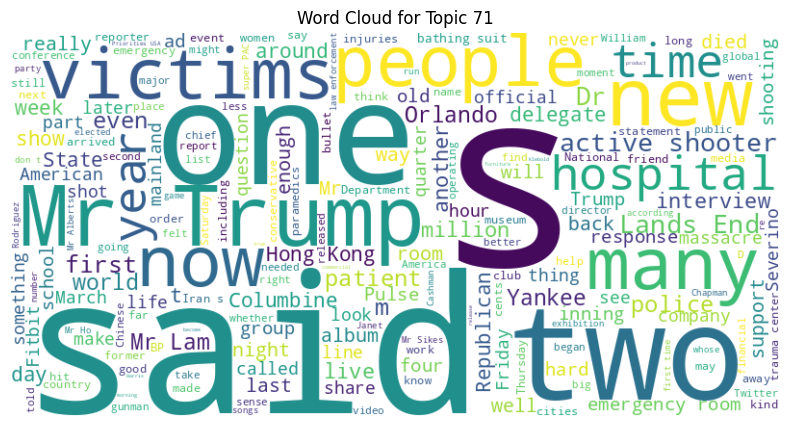

Topic Label: 29


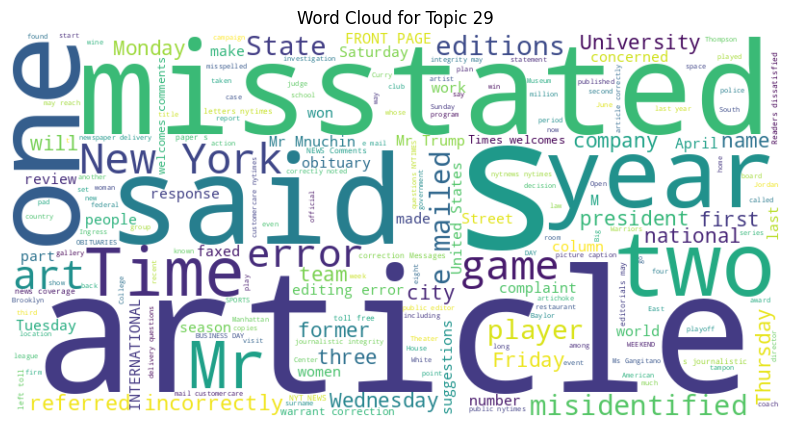

Topic Label: 54


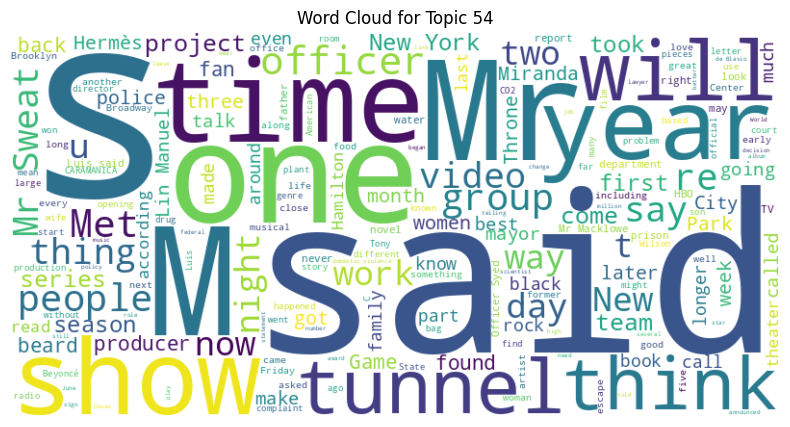

Topic Label: 28


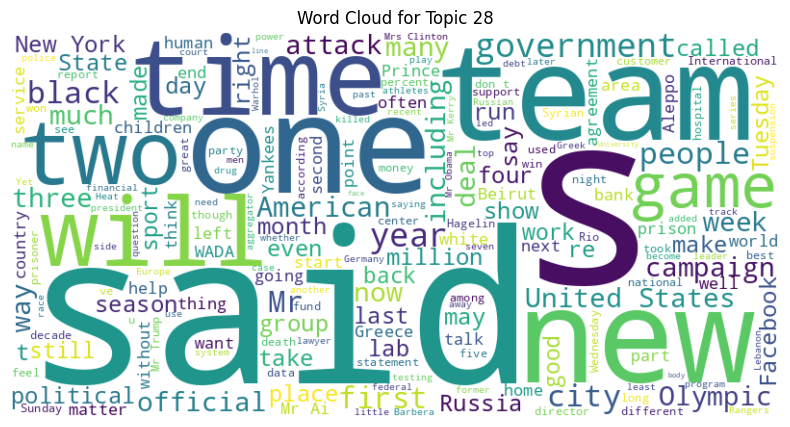

Topic Label: 73


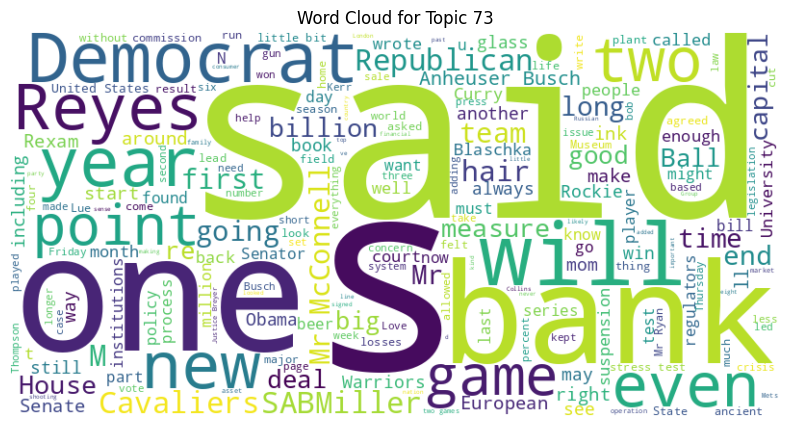

Topic Label: 61


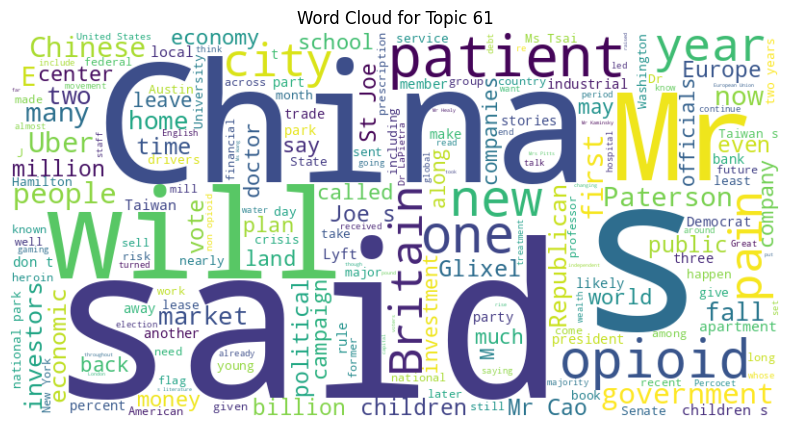

Topic Label: 85


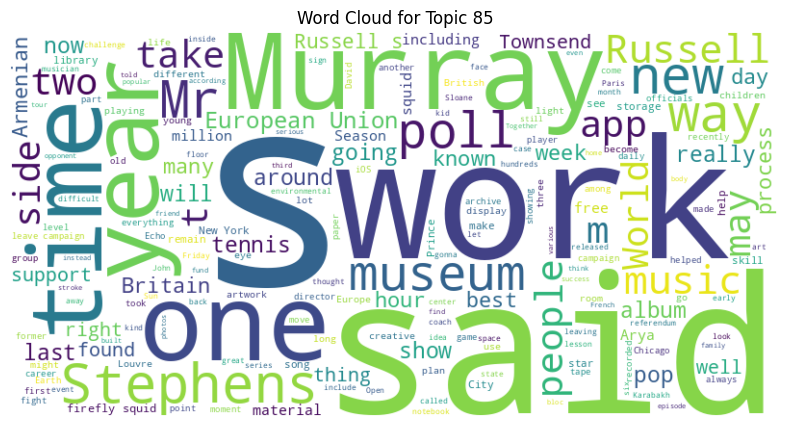

Topic Label: 52


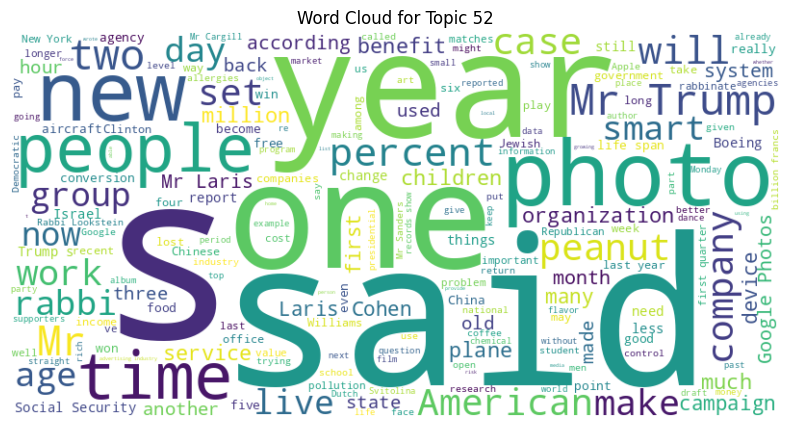

Topic Label: 37


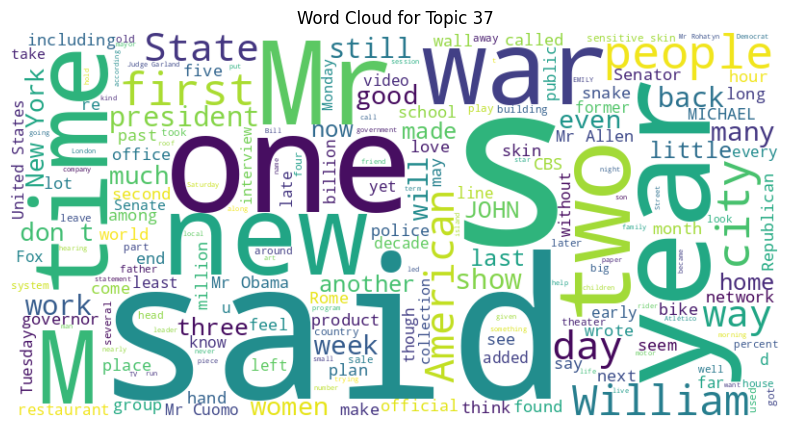

Topic Label: 89


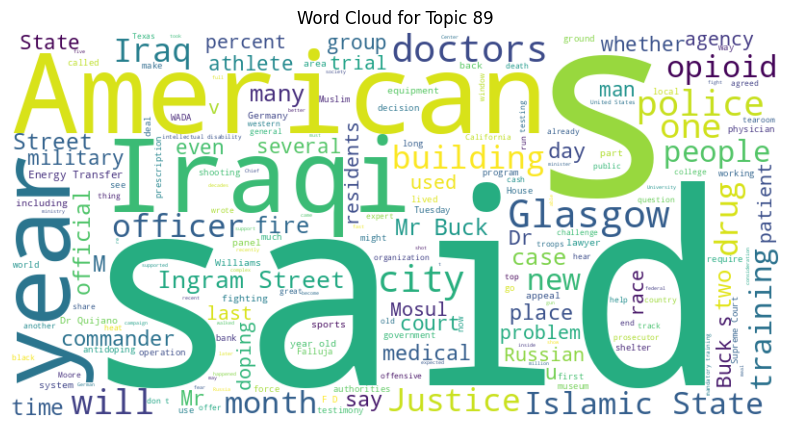

Topic Label: 51


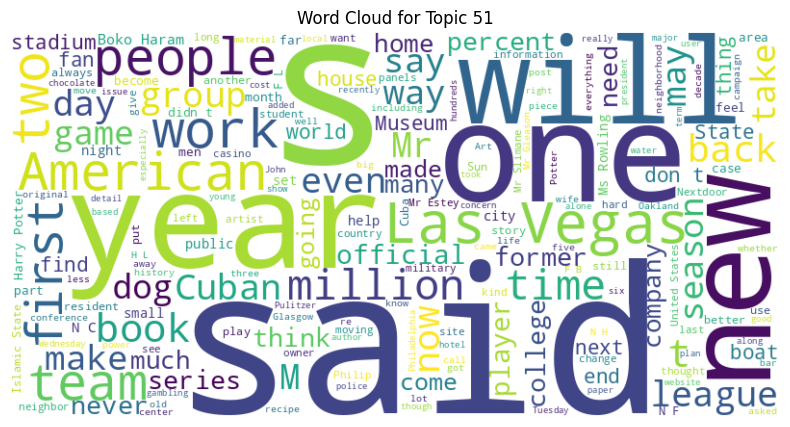

Topic Label: 75


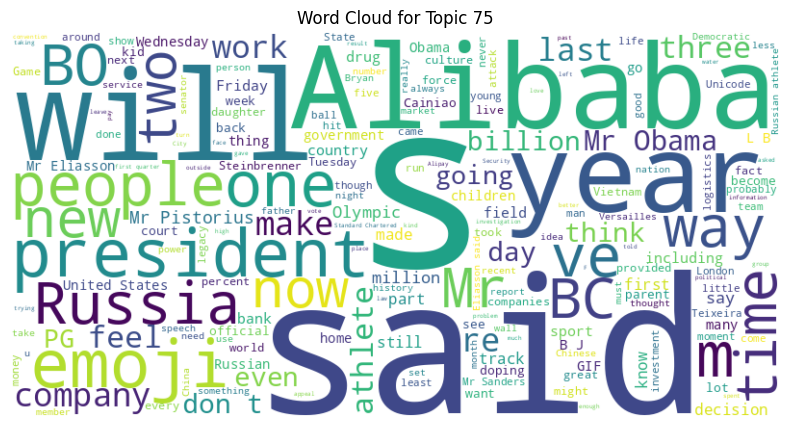

Topic Label: 81


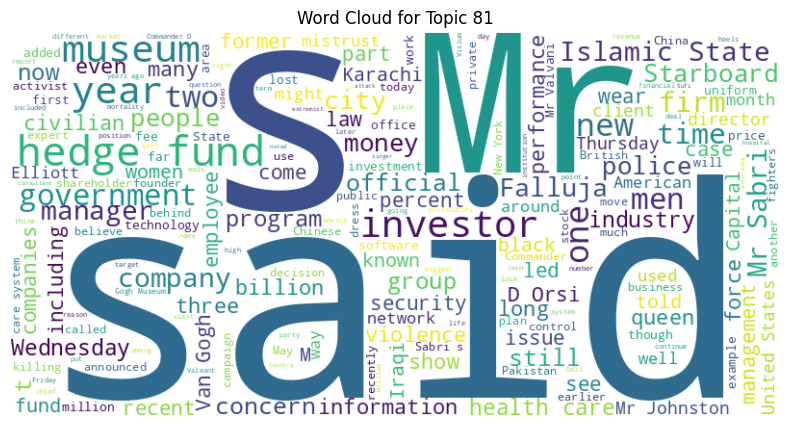

Topic Label: 56


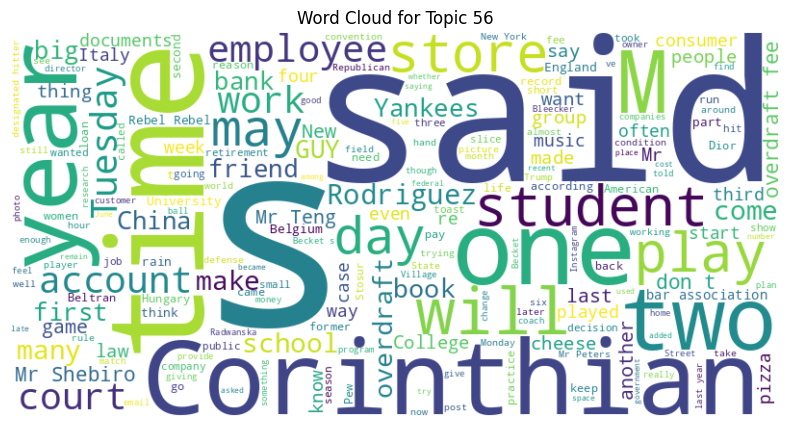

Topic Label: 72


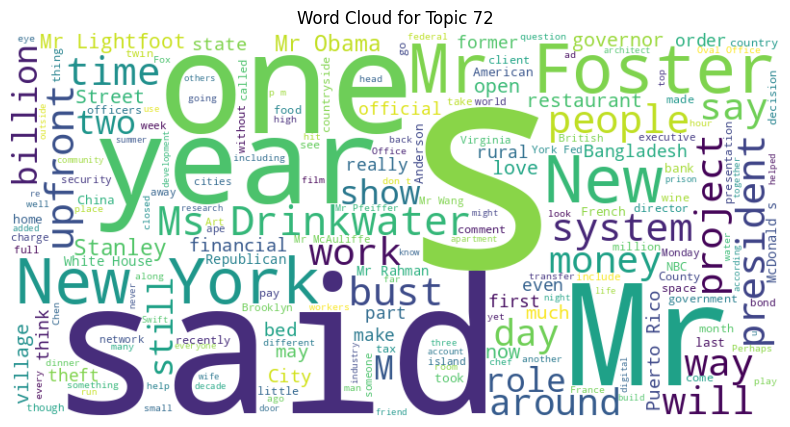

Topic Label: 38


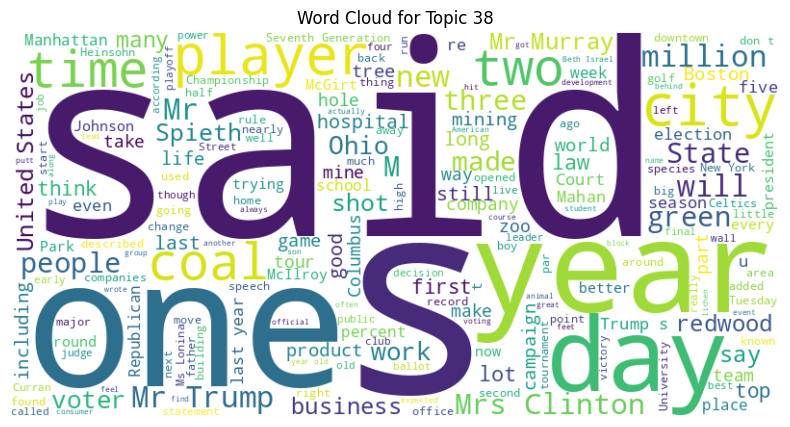

Topic Label: 87


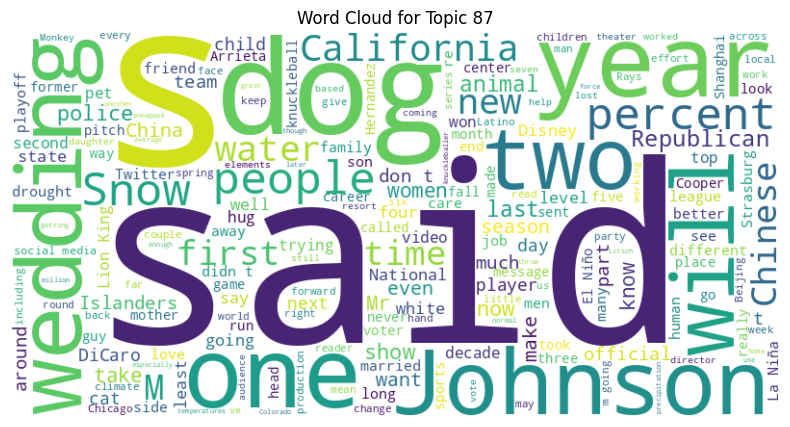

Topic Label: 86


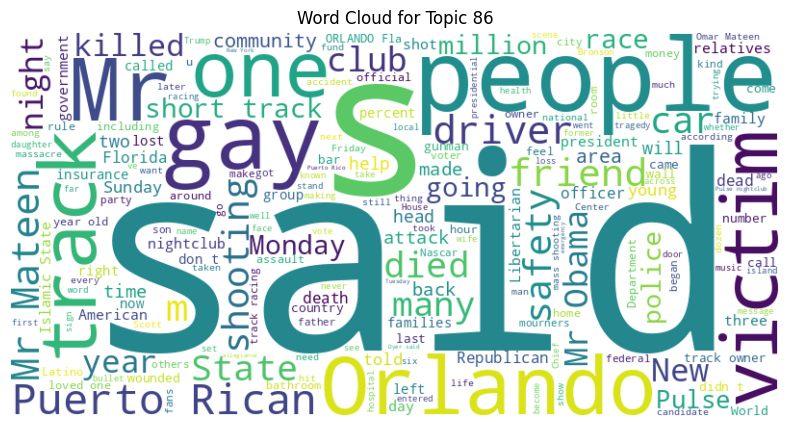

Topic Label: 49


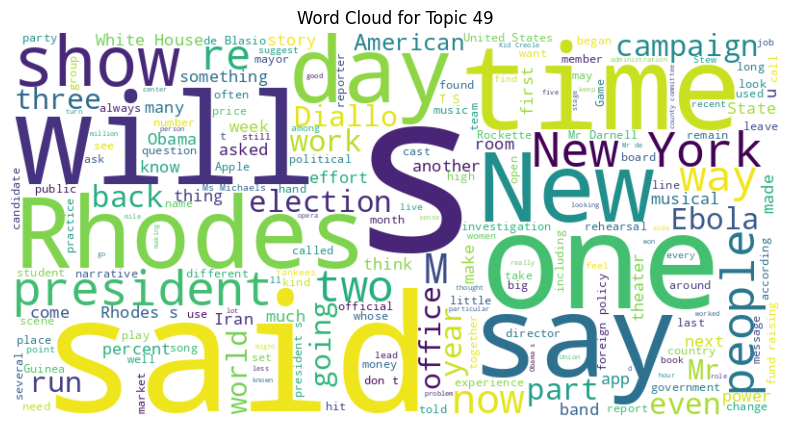

Topic Label: 69


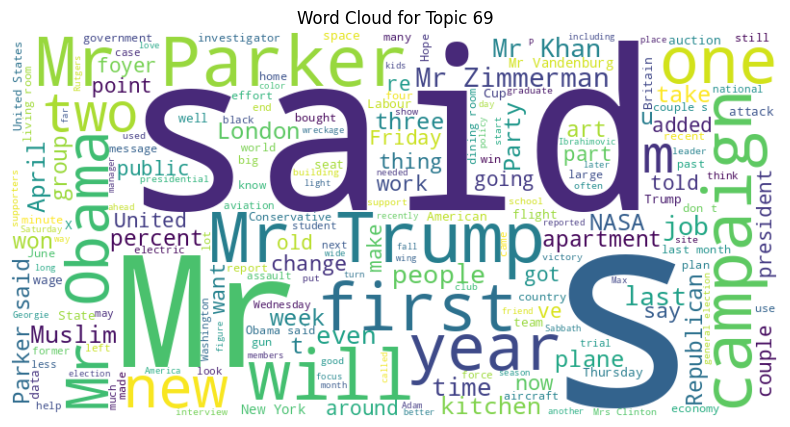

Topic Label: 53


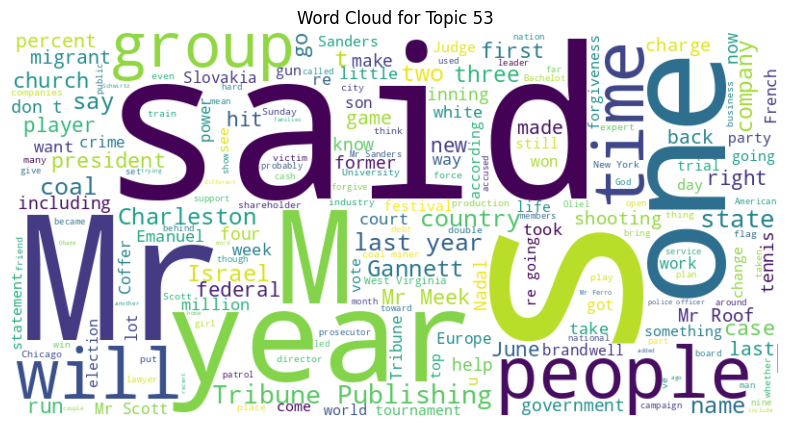

Topic Label: 60


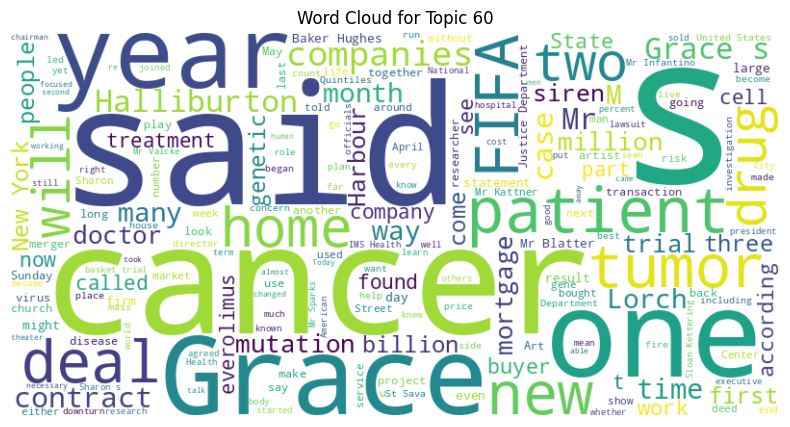

Topic Label: 76


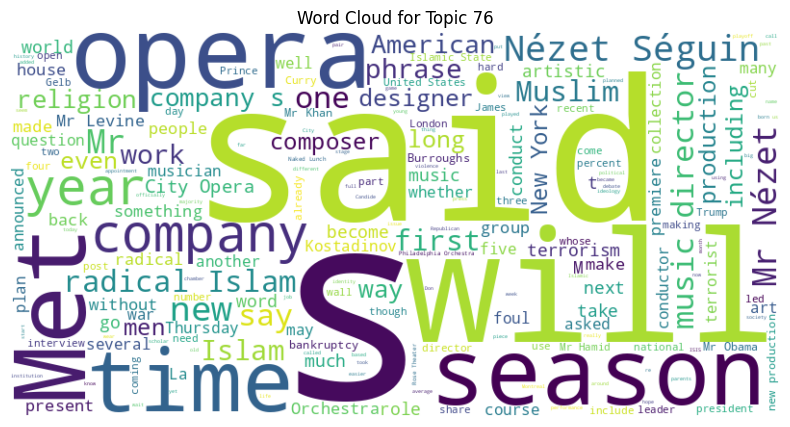

Topic Label: 79


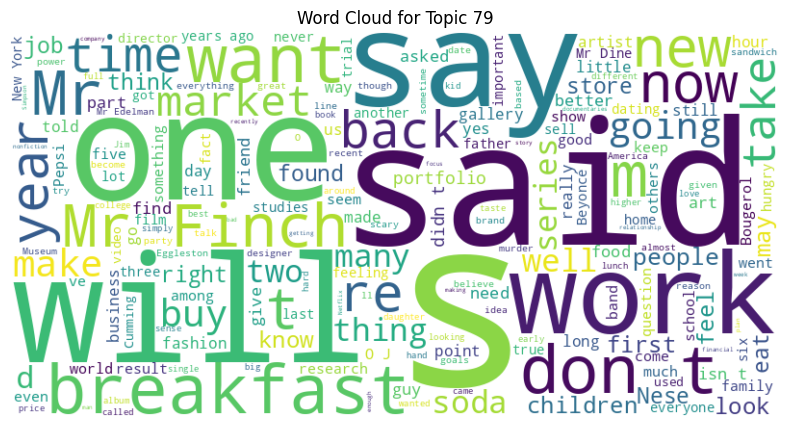

Topic Label: 83


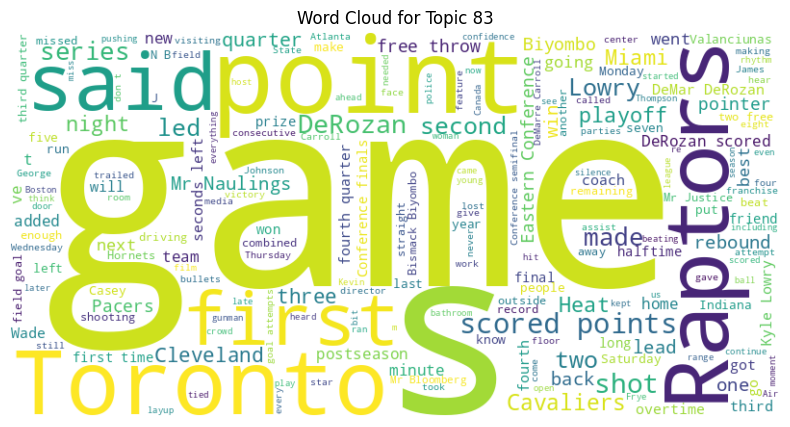

Topic Label: 92


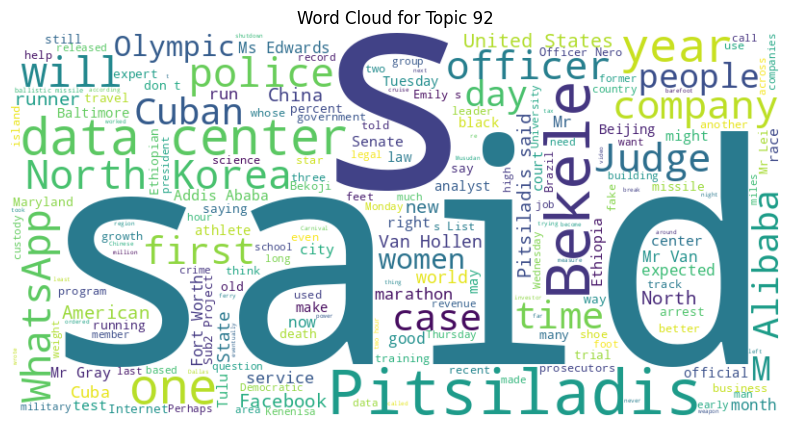

Topic Label: 78


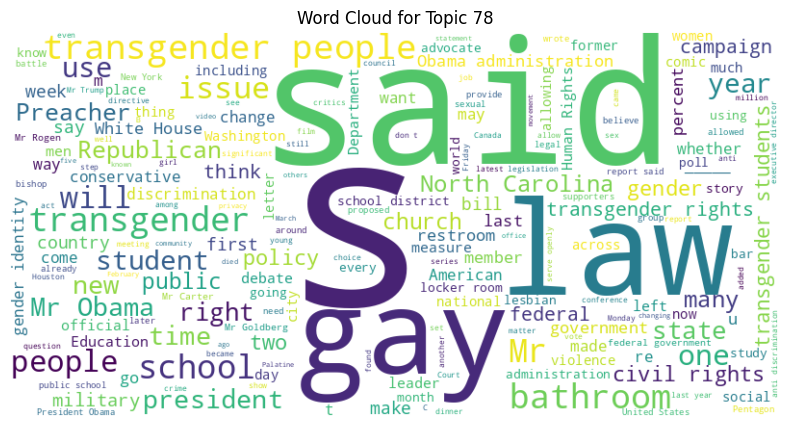

Topic Label: 82


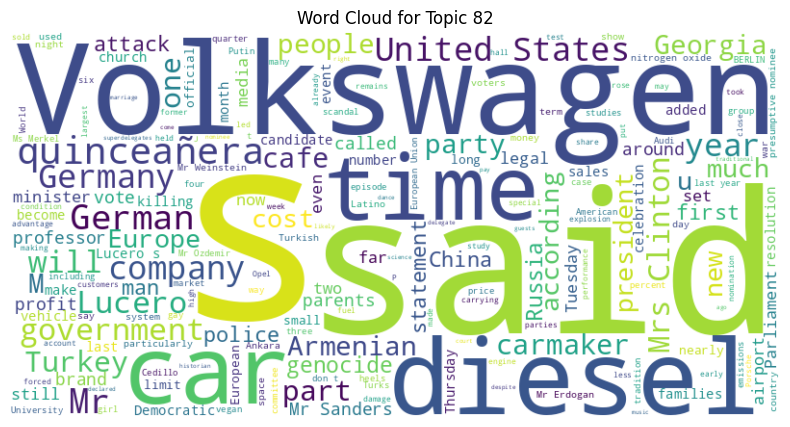

Topic Label: 68


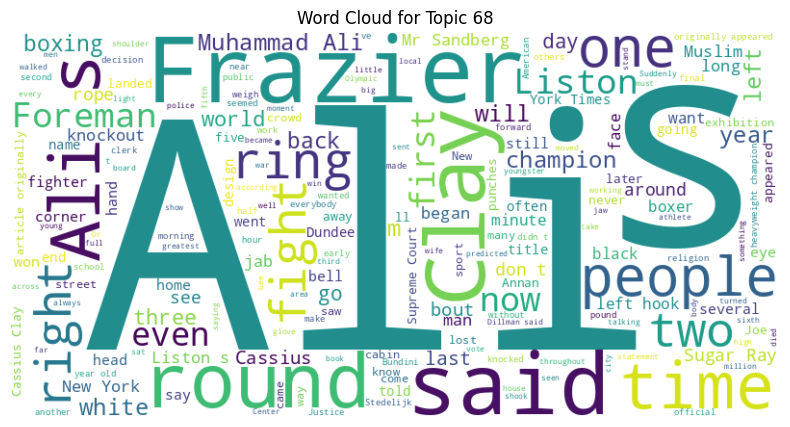

Topic Label: 63


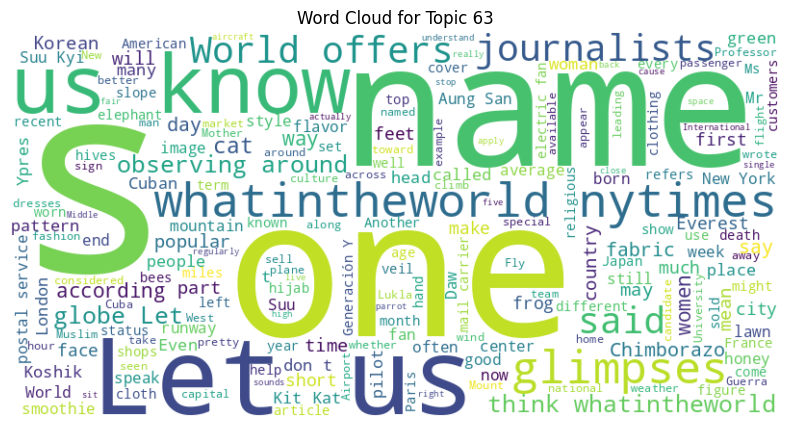

In [ ]:
# Generate word clouds for each topic
for topic_label in data['topic_label'].unique():
    print(f"Topic Label: {topic_label}")

    # Filter DataFrame by topic label
    topic_articles = data[data['topic_label'] == topic_label]

    # Concatenate text from filtered DataFrame
    text = ' '.join(topic_articles['content'])

    # Generate word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Plot word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f"Word Cloud for Topic {topic_label}")
    plt.axis('off')
    plt.show()

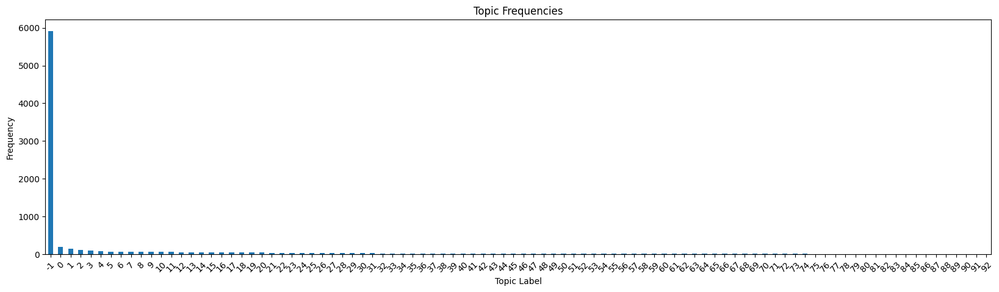

In [ ]:
# Topic Frequencies Visualization
topic_counts = data['topic_label'].value_counts().sort_index()
plt.figure(figsize=(20, 5))
topic_counts.plot(kind='bar')
plt.title('Topic Frequencies')
plt.xlabel('Topic Label')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()